In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "2,3"

In [2]:
!nvidia-smi

Fri Jan 16 12:15:21 2026       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 580.95.05              Driver Version: 580.95.05      CUDA Version: 13.0     |
+-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA RTX A6000               Off |   00000000:1B:00.0 Off |                  Off |
| 30%   32C    P8             23W /  300W |      15MiB /  49140MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [4]:
import torch
print(torch.cuda.device_count())  # should print 2
print(torch.cuda.get_device_name(0))

2
NVIDIA RTX A6000


In [4]:
!pip install pandas

In [5]:
from ultralytics import YOLO

# choose which YOLOv8 variant to test
models = [
    "yolov8n.pt",  # nano
    "yolov8s.pt",  # small
    "yolov8m.pt",  # medium
    "yolov8l.pt",  # large
    "yolov8x.pt",  # extra-large
]

DATASET = "Ev-Battery-Components-3/data.yaml"
EPOCHS = 100
BATCH = 16
IMGSZ = 640
DEVICE = "0"  # your GPUs

for weights in models:
    name = weights.replace(".pt", "")
    print(f"\n🚀 Training {name}")
    model = YOLO(weights)
    model.train(
        data=DATASET,
        epochs=EPOCHS,
        batch=BATCH,
        imgsz=IMGSZ,
        device=DEVICE,
        project="runs/yolov8",
        name=name,
        exist_ok=True
    )



🚀 Training yolov8n
New https://pypi.org/project/ultralytics/8.3.229 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48685MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=Ev-Battery-Components-3/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolov8n, nbs=64, nms=

In [1]:
import pandas as pd
from ultralytics import YOLO
import os
v8_results = []

models = ["yolov8n", "yolov8s", "yolov8m", "yolov8l", "yolov8x"]

data_yaml_path = "Ev-Battery-Components-3/data.yaml"

for name in models:
    weights_path = f"runs/yolov8/{name}/weights/best.pt"
    print(f"\nEvaluating {name}...")

    if os.path.exists(weights_path):
        model = YOLO(weights_path)
        metrics = model.val(data=data_yaml_path, imgsz=640, iou=0.7, conf=0.001)
        
        v8_results.append({
            "Model": name,
            "mAP50-95": metrics.box.map,
            "mAP50": metrics.box.map50,
            "Precision": metrics.box.mp,
            "Recall": metrics.box.mr,
        })
    else:
        v8_results.append({"Model": name, "Error": "best.pt missing"})

display(pd.DataFrame(v8_results))



Evaluating yolov8n...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CPU (Intel Xeon Gold 5218R CPU @ 2.10GHz)
Model summary (fused): 78 layers, 2,685,928 parameters, 0 gradients, 6.8 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 166.3±27.4 MB/s, size: 59.1 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 154.4Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 1.3it/s 8.0s.7ss
                   all        158        612      0.648      0.624      0.608      0.455
              b_casing         48       

,Model,mAP50-95,mAP50,Precision,Recall
0,yolov8n,0.455388,0.608310,0.648163,0.624347
1,yolov8s,0.441651,0.597952,0.633323,0.630677
2,yolov8m,0.469149,0.613174,0.766096,0.559826
3,yolov8l,0.464179,0.598956,0.699110,0.600463
4,yolov8x,0.459470,0.616499,0.682126,0.620947


In [1]:
from ultralytics import YOLO
import os
import yaml
import pandas as pd
from datetime import datetime

models = [
    "yolov9t.pt",
    "yolov9s.pt",
    "yolov9m.pt",
    "yolov9c.pt",
]

DATASET = "Ev-Battery-Components-3/data.yaml"
EPOCHS = 100
BATCH = 16
IMGSZ = 640
DEVICE = "0,1"  


for weights in models:
    name = weights.replace(".pt", "")
    print(f"\n🚀 Training {name}")

    model = YOLO(weights)

    model.train(
        data=DATASET,
        epochs=EPOCHS,
        batch=BATCH,
        imgsz=IMGSZ,
        device=DEVICE,
        project="runs/yolov9",
        name=name,
        exist_ok=True
    )

    print(f"✔️ Finished training {name}")



🚀 Training yolov9t
New https://pypi.org/project/ultralytics/8.3.230 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48685MiB)
                                                        CUDA:1 (NVIDIA RTX A6000, 48685MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=Ev-Battery-Components-3/data.yaml, degrees=0.0, deterministic=True, device=0,1, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=trai

Exception in thread Thread-2 (_pin_memory_loop):
Traceback (most recent call last):
  File "/users/2/250027044/anaconda3/envs/yolov9_custom_ultralytics/lib/python3.10/threading.py", line 1016, in _bootstrap_inner


Optimizer stripped from /home/250027044/ultralyticsWithEfficientNetB3/runs/yolov9/yolov9m/weights/best.pt, 34.0MB

Validating /home/250027044/ultralyticsWithEfficientNetB3/runs/yolov9/yolov9m/weights/best.pt...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48685MiB)
                                                        CUDA:1 (NVIDIA RTX A6000, 48685MiB)
YOLOv9m summary (fused): 157 layers, 16,580,776 parameters, 0 gradients, 60.0 GFLOPs
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 3.4it/s 3.0s.1s
                   all        158        612      0.651      0.624      0.621      0.478
              b_casing         48         48      0.927      0.833      0.867      0.775
        battery_module         57        200      0.774      0.859      0.836      0.731
              bms_unit         19         19      0.667       0.74      0.764      0.596
                busbar         39  

In [2]:
v9_results = []

models = ["yolov9t", "yolov9s", "yolov9m", "yolov9c"]
data_yaml_path = "Ev-Battery-Components-3/data.yaml"

for name in models:
    weights_path = f"runs/yolov9/{name}/weights/best.pt"
    print(f"\nEvaluating {name}...")

    if os.path.exists(weights_path):
        model = YOLO(weights_path)
        metrics = model.val(data=data_yaml_path, imgsz=640, iou=0.7, conf=0.001)

        v9_results.append({
            "Model": name,
            "mAP50-95": metrics.box.map,
            "mAP50": metrics.box.map50,
            "Precision": metrics.box.mp,
            "Recall": metrics.box.mr,
        })
    else:
        v9_results.append({"Model": name, "Error": "best.pt missing"})

display(pd.DataFrame(v9_results))



Evaluating yolov9t...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CPU (Intel Xeon Gold 5218R CPU @ 2.10GHz)
YOLOv9t summary (fused): 203 layers, 1,731,384 parameters, 0 gradients, 6.4 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 3037.8±659.1 MB/s, size: 56.4 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 454.8Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 1.2it/s 8.0s.7ss
                   all        158        612      0.666       0.58      0.606      0.454
              b_casing         48  

,Model,mAP50-95,mAP50,Precision,Recall
0,yolov9t,0.453760,0.606264,0.665975,0.579531
1,yolov9s,0.464291,0.608742,0.586268,0.656262
2,yolov9m,0.477619,0.620014,0.650883,0.624416
3,yolov9c,0.476242,0.617875,0.676008,0.634578


In [1]:
from ultralytics import YOLO
import os
import pandas as pd

# List of your custom architectures
custom_models = [
    "ultralytics/cfg/models/ablation/09_full_model.yaml",
    "ultralytics/cfg/models/additive/03_baseline_plus_hgblocks.yaml",
    "ultralytics/cfg/models/custom/custom_yolov9_outperform.yaml",
    "ultralytics/cfg/models/additive/09_additive_full_model_Fusion_FIXED.yaml",
]

DATASET = "Ev-Battery-Components-3/data.yaml"
EPOCHS = 100
BATCH = 16
IMGSZ = 640
DEVICE = "0,1"   # Multi-GPU


for yaml_file in custom_models:
    name = os.path.basename(yaml_file).replace(".yaml", "")
    print(f"\n🚀 Training custom model: {name}")

    model = YOLO(yaml_file)

    model.train(
        data=DATASET,
        epochs=EPOCHS,
        batch=BATCH,
        imgsz=IMGSZ,
        device=DEVICE,
        project="runs/custom",
        name=name,
        exist_ok=True
    )

    print(f"✔️ Finished training {name}")



🚀 Training custom model: 09_full_model
New https://pypi.org/project/ultralytics/8.3.232 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48685MiB)
                                                        CUDA:1 (NVIDIA RTX A6000, 48685MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=Ev-Battery-Components-3/data.yaml, degrees=0.0, deterministic=True, device=0,1, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, 

In [17]:
import pandas as pd

df_v8 = pd.DataFrame(v8_results)
df_v9 = pd.DataFrame(v9_results)
df_custom = pd.DataFrame(custom_results)

df_v8["Category"] = "YOLOv8"
df_v9["Category"] = "YOLOv9"
df_custom["Category"] = "Custom YOLOv9"

combined_df = pd.concat([df_v8, df_v9, df_custom], ignore_index=True)

combined_df = combined_df[["Category", "Model", "mAP50-95", "mAP50", "Precision", "Recall"]]

display(combined_df)
combined_df.to_csv("all_models_evaluation_summary.csv", index=False)

print("\n🏆 Combined leaderboard generated!")


,Category,Model,mAP50-95,mAP50,Precision,Recall
0,YOLOv8,yolov8n,0.455472,0.608301,0.647795,0.624351
1,YOLOv8,yolov8s,0.441666,0.598013,0.633299,0.630682
2,YOLOv8,yolov8m,0.469143,0.613173,0.766058,0.559835
3,YOLOv8,yolov8l,0.464255,0.599068,0.699181,0.600607
4,YOLOv8,yolov8x,0.459406,0.616425,0.682092,0.620893
5,YOLOv9,yolov9t,0.454501,0.606410,0.665665,0.579614
6,YOLOv9,yolov9s,0.464326,0.608775,0.586138,0.656258
7,YOLOv9,yolov9m,0.477517,0.619938,0.651058,0.624040
8,YOLOv9,yolov9c,0.475954,0.617856,0.675958,0.633553
9,Custom YOLOv9,09_full_model,0.425297,0.604821,0.673075,0.601789



🏆 Combined leaderboard generated!


In [3]:
custom_results = []

model_names = [
    "09_full_model",
    "03_baseline_plus_hgblocks",
    "custom_yolov9_outperform",
    "09_additive_full_model_Fusion_FIXED",
]

data_yaml_path = "Ev-Battery-Components-3/data.yaml"

for name in model_names:
    weights_path = f"runs/custom/{name}/weights/best.pt"
    print(f"\nEvaluating {name}...")

    if os.path.exists(weights_path):
        model = YOLO(weights_path)
        metrics = model.val(data=data_yaml_path, imgsz=640, iou=0.7, conf=0.001)

        custom_results.append({
            "Model": name,
            "mAP50-95": metrics.box.map,
            "mAP50": metrics.box.map50,
            "Precision": metrics.box.mp,
            "Recall": metrics.box.mr,
        })
    else:
        custom_results.append({"Model": name, "Error": "best.pt missing"})

display(pd.DataFrame(custom_results))



Evaluating 09_full_model...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CPU (Intel Xeon Gold 5218R CPU @ 2.10GHz)
09_full_model summary: 629 layers, 29,515,598 parameters, 0 gradients, 19.0 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1916.9±727.6 MB/s, size: 63.4 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 271.8Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 0.1it/s 1:15.9sss
                   all        158        612      0.673      0.602      0.605      0.425
              b_casing      

,Model,mAP50-95,mAP50,Precision,Recall
0,09_full_model,0.425311,0.604851,0.673044,0.601799
1,03_baseline_plus_hgblocks,0.440480,0.613277,0.630591,0.636714
2,custom_yolov9_outperform,0.434939,0.608246,0.692081,0.575021
3,09_additive_full_model_Fusion_FIXED,0.436828,0.607182,0.650390,0.637090


In [6]:

from ultralytics.nn.tasks import DetectionModel
import torch

cfg = "ultralytics/cfg/models/custom/modified_yolov9m.yaml"
model = DetectionModel(cfg=cfg, nc=30)

x = torch.randn(1, 3, 640, 640)
y = model(x)
print("✅ Model runs successfully! Output shapes:")
for out in (y if isinstance(y, list) else [y]):
    print(out.shape)


Overriding model.yaml nc=80 with nc=30

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [32, 3, 2]                    
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [64, 3, 2]                    
  2                  -1  1    171648  ultralytics.nn.modules.block.RepNCSPELAN4    [128, 128, 64, 1]             
  3                  -1  1    276960  ultralytics.nn.modules.block.AConv           [240]                         
  4                  -1  1    629520  ultralytics.nn.modules.block.RepNCSPELAN4    [240, 240, 120, 1]            
  5                  -1  1    778320  ultralytics.nn.modules.block.AConv           [360]                         
  6                  -1  1   1414080  ultralytics.nn.modules.block.RepNCSPELAN4    [360, 360, 180, 1]            
  7                  -1  1   1556160  ultralytic

In [8]:
from ultralytics import YOLO
import os
import yaml
import pandas as pd
from datetime import datetime

DATASET = "Ev-Battery-Components-3/data.yaml"
EPOCHS = 100
BATCH = 16
IMGSZ = 640
DEVICE = "0,1"   # Multi-GPU

model = YOLO( "ultralytics/cfg/models/custom/modified_yolov9m.yaml")
r = model.train(
    data=DATASET,
    epochs=EPOCHS,
    batch=BATCH,
    imgsz=IMGSZ,
    device=DEVICE,
    project="runs/custom",
    name="custom_yolov9m",
    exist_ok=True
)

New https://pypi.org/project/ultralytics/8.3.233 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48685MiB)
                                                        CUDA:1 (NVIDIA RTX A6000, 48685MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=Ev-Battery-Components-3/data.yaml, degrees=0.0, deterministic=True, device=0,1, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=ultralytics

In [10]:
from ultralytics import YOLO
import os
import yaml
import pandas as pd
from datetime import datetime

DATASET = "Ev-Battery-Components-3/data.yaml"
EPOCHS = 100
BATCH = 16
IMGSZ = 640
DEVICE = "0,1"   # Multi-GPU

model = YOLO( "ultralytics/cfg/models/v9/yolov9m.yaml")
r = model.train(
    data=DATASET,
    epochs=EPOCHS,
    batch=BATCH,
    imgsz=IMGSZ,
    device=DEVICE,
    project="runs/custom",
    name="custom_yolov9m",
    exist_ok=True
)

New https://pypi.org/project/ultralytics/8.3.233 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48685MiB)
                                                        CUDA:1 (NVIDIA RTX A6000, 48685MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=Ev-Battery-Components-3/data.yaml, degrees=0.0, deterministic=True, device=0,1, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=ultralytics

In [11]:
from ultralytics import YOLO
import os
import yaml
import pandas as pd
from datetime import datetime

models = [
    "ultralytics/cfg/models/v9/yolov9t.yaml",
    "ultralytics/cfg/models/v9/yolov9s.yaml",
    "ultralytics/cfg/models/v9/yolov9m.yaml",
    "ultralytics/cfg/models/v9/yolov9c.yaml",
]

DATASET = "Ev-Battery-Components-3/data.yaml"
EPOCHS = 100
BATCH = 16
IMGSZ = 640
DEVICE = "0,1"  


for weights in models:
    name = weights.replace(".pt", "")
    print(f"\n🚀 Training {name}")

    model = YOLO(weights)

    model.train(
        data=DATASET,
        epochs=EPOCHS,
        batch=BATCH,
        imgsz=IMGSZ,
        device=DEVICE,
        project="runs/yolov9inner",
        name=name,
        exist_ok=True
    )

    print(f"✔️ Finished training {name}")



🚀 Training ultralytics/cfg/models/v9/yolov9t.yaml
New https://pypi.org/project/ultralytics/8.3.233 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48685MiB)
                                                        CUDA:1 (NVIDIA RTX A6000, 48685MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=Ev-Battery-Components-3/data.yaml, degrees=0.0, deterministic=True, device=0,1, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, ma

Exception in thread Thread-2 (_pin_memory_loop):
Traceback (most recent call last):
  File "/users/2/250027044/anaconda3/envs/yolov9_custom_ultralytics/lib/python3.10/threading.py", line 1016, in _bootstrap_inner


Optimizer stripped from /home/250027044/ultralyticsWithEfficientNetB3/runs/yolov9inner/ultralytics/cfg/models/v9/yolov9m.yaml/weights/last.pt, 34.0MB
Optimizer stripped from /home/250027044/ultralyticsWithEfficientNetB3/runs/yolov9inner/ultralytics/cfg/models/v9/yolov9m.yaml/weights/best.pt, 34.0MB

Validating /home/250027044/ultralyticsWithEfficientNetB3/runs/yolov9inner/ultralytics/cfg/models/v9/yolov9m.yaml/weights/best.pt...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48685MiB)
                                                        CUDA:1 (NVIDIA RTX A6000, 48685MiB)
YOLOv9m summary (fused): 157 layers, 16,580,776 parameters, 0 gradients, 60.0 GFLOPs
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 3.5it/s 2.8s.1s
                   all        158        612      0.605      0.586      0.573      0.414
              b_casing         48         48      0.868      0.825      0.869   

In [6]:
v9_inner_results = []

models = ["yolov9t.yaml", "yolov9s.yaml", "yolov9m.yaml", "yolov9c.yaml"]
data_yaml_path = "Ev-Battery-Components-3/data.yaml"

for name in models:
    weights_path = f"runs/yolov9inner/ultralytics/cfg/models/v9/{name}/weights/best.pt"
    print(f"\nEvaluating {name}...")

    if os.path.exists(weights_path):
        model = YOLO(weights_path)
        metrics = model.val(data=data_yaml_path, imgsz=640, iou=0.7, conf=0.001)

        v9_inner_results.append({
            "Model": name,
            "mAP50-95": metrics.box.map,
            "mAP50": metrics.box.map50,
            "Precision": metrics.box.mp,
            "Recall": metrics.box.mr,
        })
    else:
        v9_inner_results.append({"Model": name, "Error": "best.pt missing"})

display(pd.DataFrame(v9_inner_results))



Evaluating yolov9t.yaml...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CPU (Intel Xeon Gold 5218R CPU @ 2.10GHz)
YOLOv9t summary (fused): 203 layers, 1,731,384 parameters, 0 gradients, 6.4 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2795.4±686.9 MB/s, size: 61.9 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 195.8Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 1.2it/s 8.6s.8ss
                   all        158        612      0.525      0.554      0.495      0.344
              b_casing        

,Model,mAP50-95,mAP50,Precision,Recall
0,yolov9t.yaml,0.344383,0.494999,0.524915,0.554249
1,yolov9s.yaml,0.398757,0.577898,0.594132,0.604004
2,yolov9m.yaml,0.413347,0.573834,0.604192,0.585694
3,yolov9c.yaml,0.424215,0.583799,0.643609,0.564313


In [7]:
from ultralytics import YOLO

# choose which YOLOv8 variant to test
models = [
    "ultralytics/cfg/models/v8/yolov8n.yaml",  # nano
    "ultralytics/cfg/models/v8/yolov8s.yaml",  # small
    "ultralytics/cfg/models/v8/yolov8m.yaml",  # medium
    "ultralytics/cfg/models/v8/yolov8l.yaml",  # large
    "ultralytics/cfg/models/v8/yolov8x.yaml",  # extra-large
]

DATASET = "Ev-Battery-Components-3/data.yaml"
EPOCHS = 100
BATCH = 16
IMGSZ = 640
DEVICE = "0"  # your GPUs

for weights in models:
    name = weights.replace(".pt", "")
    print(f"\n🚀 Training {name}")
    model = YOLO(weights)
    model.train(
        data=DATASET,
        epochs=EPOCHS,
        batch=BATCH,
        imgsz=IMGSZ,
        device=DEVICE,
        project="runs/yolov8inner",
        name=name,
        exist_ok=True
    )



🚀 Training ultralytics/cfg/models/v8/yolov8n.yaml
New https://pypi.org/project/ultralytics/8.3.233 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48685MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=Ev-Battery-Components-3/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=ultralytics/cfg/models/v8/yolov8n.yaml, momentum=0.937

In [4]:
v8_inner_results = []

models = ["yolov8n.yaml", "yolov8s.yaml", "yolov8m.yaml", "yolov8l.yaml", "yolov8x.yaml"]
data_yaml_path = "Ev-Battery-Components-3/data.yaml"

for name in models:
    weights_path = f"runs/yolov8inner/ultralytics/cfg/models/v8/{name}/weights/best.pt"
    print(f"\nEvaluating {name}...")

    if os.path.exists(weights_path):
        model = YOLO(weights_path)
        metrics = model.val(data=data_yaml_path, imgsz=640, iou=0.7, conf=0.001)

        v8_inner_results.append({
            "Model": name,
            "mAP50-95": metrics.box.map,
            "mAP50": metrics.box.map50,
            "Precision": metrics.box.mp,
            "Recall": metrics.box.mr,
        })
    else:
        v8_inner_results.append({"Model": name, "Error": "best.pt missing"})

display(pd.DataFrame(v8_inner_results))



Evaluating yolov8n.yaml...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CPU (Intel Xeon Gold 5218R CPU @ 2.10GHz)
YOLOv8n summary (fused): 78 layers, 2,685,928 parameters, 0 gradients, 6.8 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1957.4±360.9 MB/s, size: 58.7 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 196.8Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 1.3it/s 7.8s.7ss
                   all        158        612      0.557      0.588      0.543      0.359
              b_casing         

,Model,mAP50-95,mAP50,Precision,Recall
0,yolov8n.yaml,0.358666,0.542654,0.557040,0.587849
1,yolov8s.yaml,0.399754,0.563266,0.627504,0.580462
2,yolov8m.yaml,0.414298,0.573431,0.567987,0.621185
3,yolov8l.yaml,0.420668,0.585121,0.622189,0.594219
4,yolov8x.yaml,0.418910,0.580132,0.569027,0.628880


In [7]:
import pandas as pd
df_v8 = pd.DataFrame(v8_results)
df_v9 = pd.DataFrame(v9_results)
df_v8_inner = pd.DataFrame(v8_inner_results)
df_v9_inner = pd.DataFrame(v9_inner_results)
df_custom = pd.DataFrame(custom_results)

df_v8["Category"] = "YOLOv8 PT"
df_v9["Category"] = "YOLOv9 PT"
df_v8_inner["Category"] = "YOLOv8 YAML"
df_v9_inner["Category"] = "YOLOv9 YAML"
df_custom["Category"] = "Custom YOLOv9 YAML"

combined_df = pd.concat([df_v8, df_v9, df_v8_inner, df_v9_inner, df_custom], ignore_index=True)

combined_df = combined_df[["Category", "Model", "mAP50-95", "mAP50", "Precision", "Recall"]]

display(combined_df)
combined_df.to_csv("all_models_evaluation_summary.csv", index=False)

print("\n🏆 Combined leaderboard generated!")


,Category,Model,mAP50-95,mAP50,Precision,Recall
0,YOLOv8 PT,yolov8n,0.455388,0.608310,0.648163,0.624347
1,YOLOv8 PT,yolov8s,0.441651,0.597952,0.633323,0.630677
2,YOLOv8 PT,yolov8m,0.469149,0.613174,0.766096,0.559826
3,YOLOv8 PT,yolov8l,0.464179,0.598956,0.699110,0.600463
4,YOLOv8 PT,yolov8x,0.459470,0.616499,0.682126,0.620947
5,YOLOv9 PT,yolov9t,0.453760,0.606264,0.665975,0.579531
6,YOLOv9 PT,yolov9s,0.464291,0.608742,0.586268,0.656262
7,YOLOv9 PT,yolov9m,0.477619,0.620014,0.650883,0.624416
8,YOLOv9 PT,yolov9c,0.476242,0.617875,0.676008,0.634578
9,YOLOv8 YAML,yolov8n.yaml,0.358666,0.542654,0.557040,0.587849



🏆 Combined leaderboard generated!


In [1]:
from ultralytics import YOLO
import os

# Define the best custom architecture file
CUSTOM_YAML = "ultralytics/cfg/models/additive/03_baseline_plus_hgblocks.yaml"

# Define the source of the pre-trained weights
PRETRAINED_WEIGHTS = "yolov9m.pt"

# Training parameters
DATASET = "Ev-Battery-Components-3/data.yaml"
EPOCHS = 100
BATCH = 16
IMGSZ = 640
DEVICE = "0"  

# Define a unique name for this run
name = "03_HG_Custom_Transfer_YOLOv9m" 

print(f"\n🚀 Training custom model with transfer learning: {name}")

# 1. Load the custom architecture (from .yaml)
model = YOLO(CUSTOM_YAML)

# 2. Load the pre-trained weights onto the custom architecture
# This transfers the knowledge from the official yolov9m.pt file
print(f"🔄 Loading weights from {PRETRAINED_WEIGHTS} onto custom architecture...")
model.load(PRETRAINED_WEIGHTS) # <--- CORRECT METHOD FOR WEIGHT TRANSFER

# 3. Start fine-tuning the model on your custom dataset
model.train(
    data=DATASET,
    epochs=EPOCHS,
    batch=BATCH,
    imgsz=IMGSZ,
    device=DEVICE,
    project="runs/custom_transfer",
    name=name,
    # NOTE: Do NOT use the 'weights=' argument here when using .load() prior.
    exist_ok=True
)

print(f"✔️ Finished training {name}")


🚀 Training custom model with transfer learning: 03_HG_Custom_Transfer_YOLOv9m
🔄 Loading weights from yolov9m.pt onto custom architecture...
Transferred 0/933 items from pretrained weights
New https://pypi.org/project/ultralytics/8.3.233 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48685MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=Ev-Battery-Components-3/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_widt

/users/2/250027044/anaconda3/envs/yolov9_custom_ultralytics/lib/python3.10/site-packages/torch/cuda/__init__.py:546: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")


  0                  -1  1  10696232  ultralytics.nn.modules.efficientnet_backbone.EfficientNetBackbone['efficientnet_b3', True, [2, 3, 4]]
  1                  -1  1         0  ultralytics.nn.modules.hybrid_blocks.Adapter [1280, 256]                   
  2                  -1  1         0  ultralytics.nn.modules.hybrid_blocks.FABlock [256]                         
  3                  -1  1         0  ultralytics.nn.modules.hybrid_blocks.MyHGBlock[256, 256, 3, 1]              
  4                  -1  1    885504  ultralytics.nn.modules.conv.Conv             [384, 3, 2]                   
  5                  -1  1         0  ultralytics.nn.modules.hybrid_blocks.FABlock [384]                         
  6                  -1  1         0  ultralytics.nn.modules.hybrid_blocks.MyHGBlock[384, 384, 3, 1]              
  7                  -1  1         0  ultralytics.nn.modules.hybrid_blocks.Adapter [512, 256]                    
  8                  -1  1         0  torch.nn.modules.linea

In [1]:
import os
import shutil
from pathlib import Path
import math
import matplotlib.pyplot as plt
from PIL import Image
from ultralytics import YOLO

# ----------------------------
# CONFIG
# ----------------------------
MODELS = ["yolov8n", "yolov8s", "yolov8m", "yolov8l", "yolov8x"]
DATA_YAML = "Ev-Battery-Components-3/data.yaml"
IMGSZ = 640
IOU = 0.7
CONF = 0.001

# Where your trained weights are
WEIGHTS_FMT = "runs/yolov8/{name}/weights/best.pt"

# Where to save each model's val predictions (so you control the folder name)
OUT_ROOT = Path("runs/report_val/yolov8")  # new clean location
OUT_ROOT.mkdir(parents=True, exist_ok=True)

# Report figure export folder
EXPORT_DIR = Path("report_figures/yolov8")
EXPORT_DIR.mkdir(parents=True, exist_ok=True)

# Display settings
COLS = 3
FIG_W = 14
MAX_SHOW_PER_MODEL = 6   # show first N images per model for quick review
TARGET_TOTAL_REPORT_IMAGES = 10  # choose 5-10 total images for paper


# ----------------------------
# HELPERS
# ----------------------------
def open_img(p, max_size=(1600,1600)):
    img = Image.open(p).convert("RGB")
    img.thumbnail(max_size)
    return img

def show_grid(paths, title="", cols=COLS):
    paths = list(paths)
    n = len(paths)
    if n == 0:
        print(f"[No images found] {title}")
        return
    rows = math.ceil(n / cols)
    plt.figure(figsize=(FIG_W, rows * 4.5))
    for i, p in enumerate(paths, 1):
        ax = plt.subplot(rows, cols, i)
        ax.imshow(open_img(p))
        ax.set_title(Path(p).name, fontsize=10)
        ax.axis("off")
    plt.suptitle(title, fontsize=14, y=1.02)
    plt.tight_layout()
    plt.show()

def find_val_pred_images(run_dir: Path):
    # Ultralytics typically writes val_batch*_pred.* for detect val runs
    patterns = ["val_batch*_pred.jpg", "val_batch*_pred.png"]
    imgs = []
    for pat in patterns:
        imgs.extend(sorted(run_dir.glob(pat)))
    return imgs

def safe_copy(src: Path, dst: Path):
    dst.parent.mkdir(parents=True, exist_ok=True)
    shutil.copy2(src, dst)


# ----------------------------
# 1) RUN VALIDATION AND SAVE PRED IMAGES (OPTIONAL)
# ----------------------------
# If you ALREADY have val folders with images, you can skip this cell block by setting RUN_VAL=False.
RUN_VAL = True

val_runs = {}  # model_name -> output_dir

if RUN_VAL:
    for name in MODELS:
        weights_path = Path(WEIGHTS_FMT.format(name=name))
        print(f"\nEvaluating {name}...")
        if not weights_path.exists():
            print(f"  [SKIP] Missing weights: {weights_path}")
            continue

        model = YOLO(str(weights_path))

        # Force a deterministic output directory per model:
        # project=<OUT_ROOT>, name=<model>, exist_ok=True
        metrics = model.val(
            data=DATA_YAML,
            imgsz=IMGSZ,
            iou=IOU,
            conf=CONF,
            project=str(OUT_ROOT),
            name=name,
            exist_ok=True,
            save=True,        # IMPORTANT: saves predicted images
            save_txt=False,
            plots=True        # saves curves/confusion matrix too
        )

        out_dir = OUT_ROOT / name
        val_runs[name] = out_dir
        print(f"  Saved outputs to: {out_dir.resolve()}")
else:
    # If you skipped validation, point val_runs to existing folders manually:
    # Example: val_runs["yolov8n"] = Path("runs/detect/val83")
    pass


# ----------------------------
# 2) PREVIEW AVAILABLE QUALITATIVE IMAGES PER MODEL
# ----------------------------
all_model_images = {}
for name in MODELS:
    run_dir = val_runs.get(name, None)
    if run_dir is None or not run_dir.exists():
        continue
    imgs = find_val_pred_images(run_dir)
    all_model_images[name] = imgs

    print(f"\n{name}: found {len(imgs)} qualitative pred images in {run_dir}")
    show_grid(imgs[:MAX_SHOW_PER_MODEL], title=f"{name} — preview (first {min(MAX_SHOW_PER_MODEL, len(imgs))})")


# ----------------------------
# 3) SELECT 5–10 IMAGES FOR THE PAPER (RECOMMENDED STRATEGY)
# ----------------------------
# Strategy:
# - pick 1 "good" + 1 "hard/failure" per model if possible (=> up to 10 images)
# - if a model has few images, take what exists
#
# Since we can't automatically detect "hard scenes" without GT/analysis,
# we will pick images by index and let you adjust quickly.

# Default picks: first two per model (edit these indices after you preview)
PICKS = {
    "yolov8n": [0, 1],
    "yolov8s": [0, 1],
    "yolov8m": [0, 1],
    "yolov8l": [0, 1],
    "yolov8x": [0, 1],
}

selected = []
for name, idxs in PICKS.items():
    imgs = all_model_images.get(name, [])
    for idx in idxs:
        if 0 <= idx < len(imgs):
            selected.append((name, imgs[idx]))

# Trim to your target (5–10)
selected = selected[:TARGET_TOTAL_REPORT_IMAGES]

print("\n==============================")
print("REPORT SHORTLIST (YOLOv8)")
print("==============================")
print(f"Selected {len(selected)} images total.\n")

# Display shortlist in a grid
show_grid([p for _, p in selected], title="YOLOv8 shortlisted report images", cols=COLS)

# Print full paths (so you can cite and copy precisely)
for name, p in selected:
    print(f"{name}: {p.resolve()}")


# ----------------------------
# 4) EXPORT SELECTED IMAGES INTO report_figures/yolov8/
# ----------------------------
for i, (name, src) in enumerate(selected, 1):
    dst = EXPORT_DIR / f"{i:02d}_{name}_{src.name}"
    safe_copy(Path(src), dst)

print(f"\nExported {len(selected)} images to: {EXPORT_DIR.resolve()}")
print("You can now use these directly in LaTeX: images/report_figures/yolov8/...")



Evaluating yolov8n...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
Model summary (fused): 78 layers, 2,685,928 parameters, 0 gradients, 6.8 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2094.5±595.2 MB/s, size: 64.1 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 188.4Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 5.5it/s 1.8s0.2s
                   all        158        612      0.648      0.624      0.608      0.455
              b_casing         48         48

<Figure size 1400x450 with 3 Axes>


yolov8s: found 3 qualitative pred images in runs/report_val/yolov8/yolov8s


<Figure size 1400x450 with 3 Axes>


yolov8m: found 3 qualitative pred images in runs/report_val/yolov8/yolov8m


<Figure size 1400x450 with 3 Axes>


yolov8l: found 3 qualitative pred images in runs/report_val/yolov8/yolov8l


<Figure size 1400x450 with 3 Axes>


yolov8x: found 3 qualitative pred images in runs/report_val/yolov8/yolov8x


<Figure size 1400x450 with 3 Axes>


REPORT SHORTLIST (YOLOv8)
Selected 10 images total.



<Figure size 1400x1800 with 10 Axes>

yolov8n: /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8n/val_batch0_pred.jpg
yolov8n: /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8n/val_batch1_pred.jpg
yolov8s: /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8s/val_batch0_pred.jpg
yolov8s: /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8s/val_batch1_pred.jpg
yolov8m: /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8m/val_batch0_pred.jpg
yolov8m: /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8m/val_batch1_pred.jpg
yolov8l: /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8l/val_batch0_pred.jpg
yolov8l: /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8l/val_batch1_pred.jpg
yolov8x: /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8x/val_batch0_pred.jpg
yolov8x: /home/250027044/ultralyticsWithEffici


YOLOv8n: showing 2 images from runs/report_val/yolov8/yolov8n
  /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8n/val_batch0_pred.jpg
  /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8n/val_batch1_pred.jpg


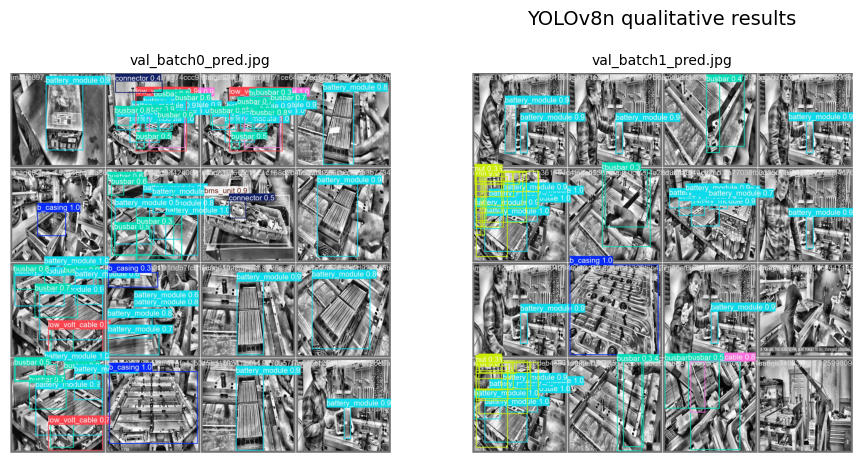


YOLOv8s: showing 2 images from runs/report_val/yolov8/yolov8s
  /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8s/val_batch0_pred.jpg
  /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8s/val_batch1_pred.jpg


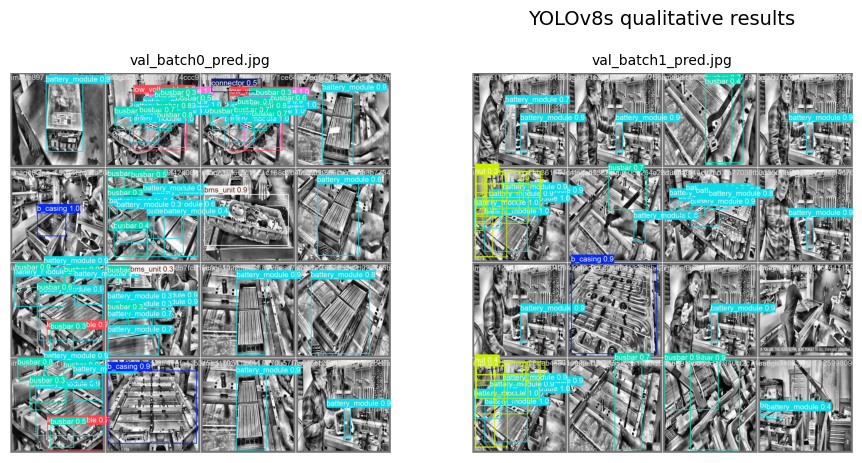


YOLOv8m: showing 2 images from runs/report_val/yolov8/yolov8m
  /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8m/val_batch0_pred.jpg
  /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8m/val_batch1_pred.jpg


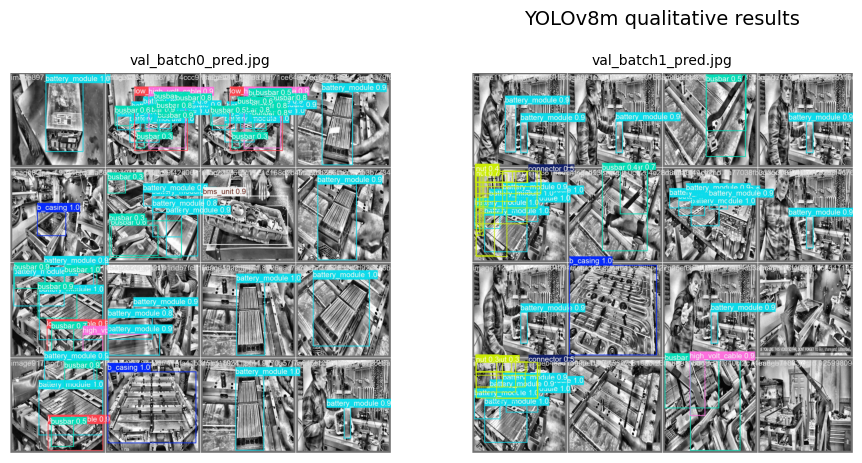


YOLOv8l: showing 2 images from runs/report_val/yolov8/yolov8l
  /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8l/val_batch0_pred.jpg
  /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8l/val_batch1_pred.jpg


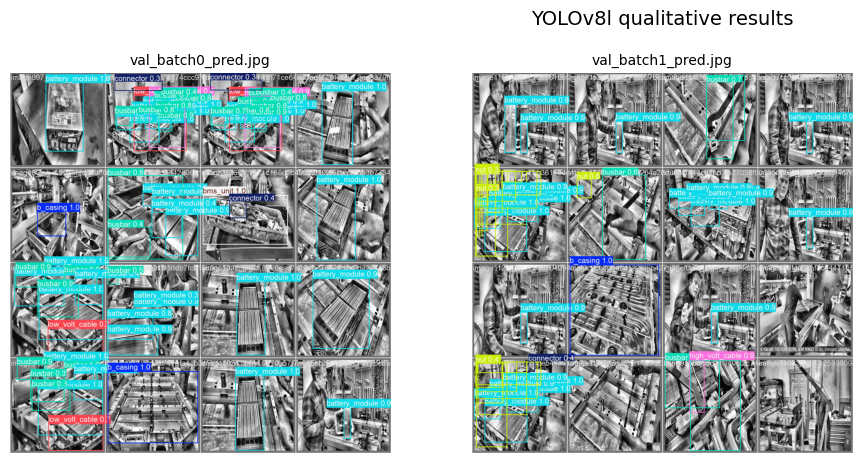


YOLOv8x: showing 2 images from runs/report_val/yolov8/yolov8x
  /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8x/val_batch0_pred.jpg
  /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov8/yolov8x/val_batch1_pred.jpg


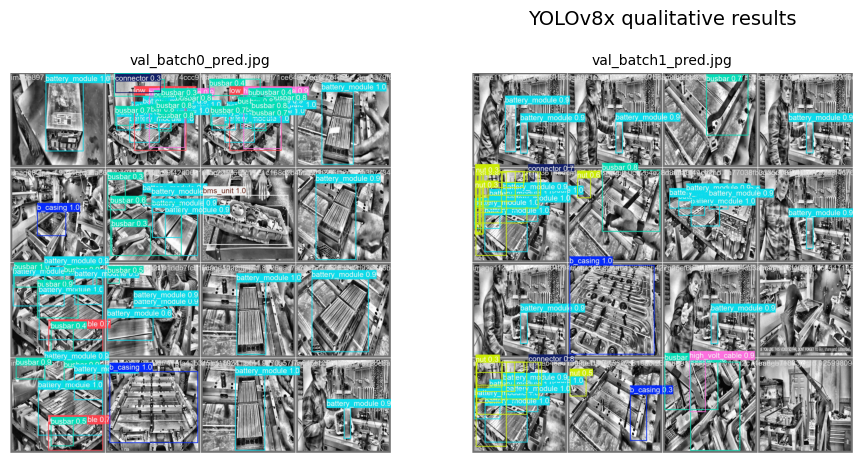

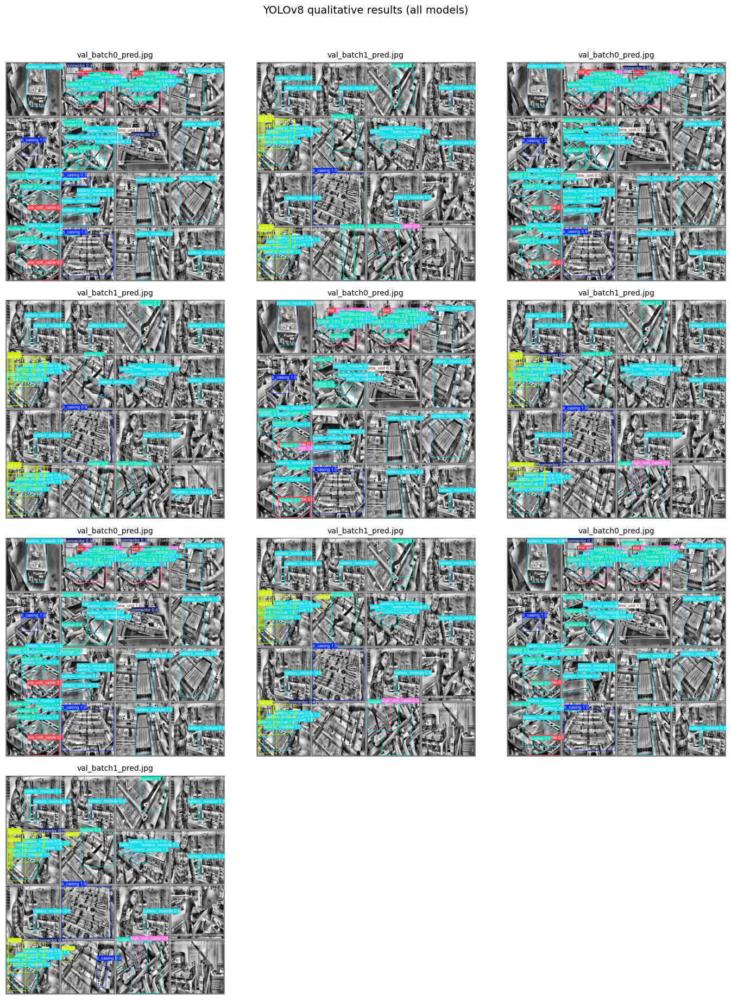

In [1]:
from pathlib import Path
import math
import matplotlib.pyplot as plt
from PIL import Image

# ----------------------------
# CONFIG
# ----------------------------
# Folder where YOLOv8 val images are stored
# (use runs/report_val/yolov8 if you followed the previous notebook,
#  otherwise update to runs/detect/val83 etc.)
YOLOV8_RUNS = {
    "YOLOv8n": "runs/report_val/yolov8/yolov8n",
    "YOLOv8s": "runs/report_val/yolov8/yolov8s",
    "YOLOv8m": "runs/report_val/yolov8/yolov8m",
    "YOLOv8l": "runs/report_val/yolov8/yolov8l",
    "YOLOv8x": "runs/report_val/yolov8/yolov8x",
}

# How many images per model to display
IMAGES_PER_MODEL = 2

COLS = 3
FIG_W = 14
MAX_IMG_SIZE = (1600, 1600)

# ----------------------------
# HELPERS
# ----------------------------
def load_image(path):
    img = Image.open(path).convert("RGB")
    img.thumbnail(MAX_IMG_SIZE)
    return img

def show_images(image_paths, title):
    if not image_paths:
        print(f"No images found for {title}")
        return
    rows = math.ceil(len(image_paths) / COLS)
    plt.figure(figsize=(FIG_W, rows * 4.5))
    for i, p in enumerate(image_paths, 1):
        ax = plt.subplot(rows, COLS, i)
        ax.imshow(load_image(p))
        ax.set_title(p.name, fontsize=10)
        ax.axis("off")
    plt.suptitle(title, fontsize=14, y=1.02)
    plt.tight_layout()
    plt.show()

# ----------------------------
# DISPLAY YOLOv8 RESULTS
# ----------------------------
all_selected = []

for model_name, run_path in YOLOV8_RUNS.items():
    run_dir = Path(run_path)
    if not run_dir.exists():
        print(f"[SKIP] Folder not found: {run_dir}")
        continue

    # Collect predicted validation images
    images = sorted(run_dir.glob("val_batch*_pred.*"))
    selected = images[:IMAGES_PER_MODEL]

    print(f"\n{model_name}: showing {len(selected)} images from {run_dir}")
    for img in selected:
        print(" ", img.resolve())

    show_images(selected, title=f"{model_name} qualitative results")
    all_selected.extend(selected)

# ----------------------------
# FINAL COMBINED VIEW (ALL YOLOv8)
# ----------------------------
show_images(
    all_selected,
    title="YOLOv8 qualitative results (all models)"
)



=== yolov8n ===


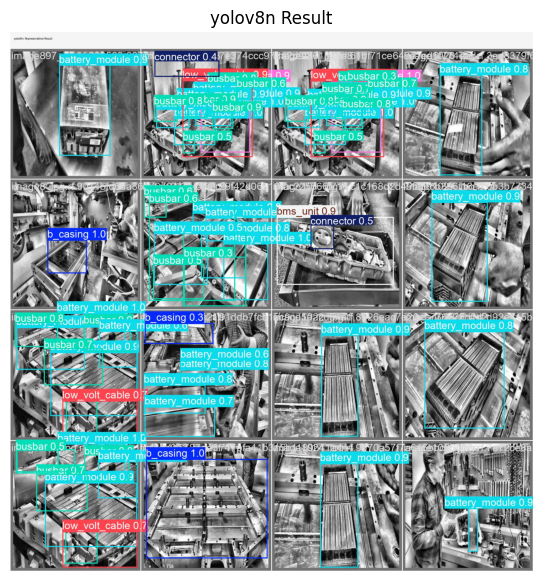

Saved: report_figures/yolov8/yolov8n/yolov8n_B_result.png


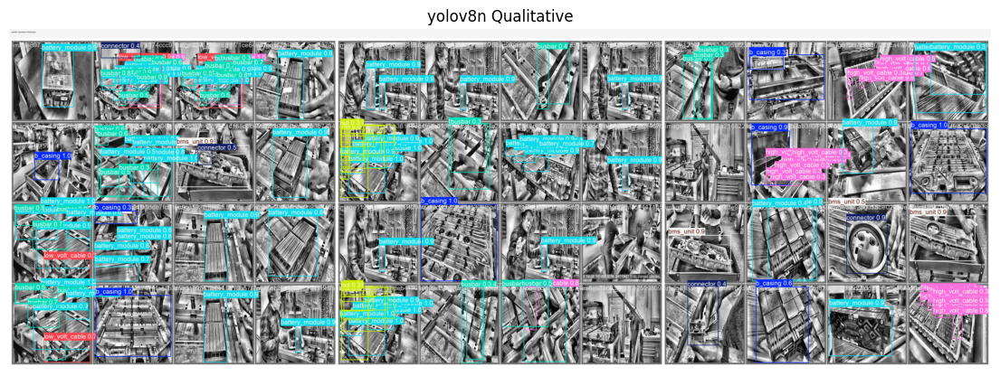

Saved: report_figures/yolov8/yolov8n/yolov8n_C_qualitative.png

=== yolov8s ===


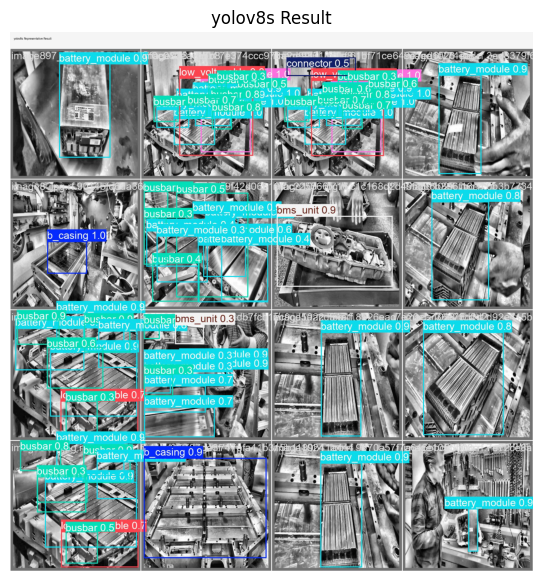

Saved: report_figures/yolov8/yolov8s/yolov8s_B_result.png


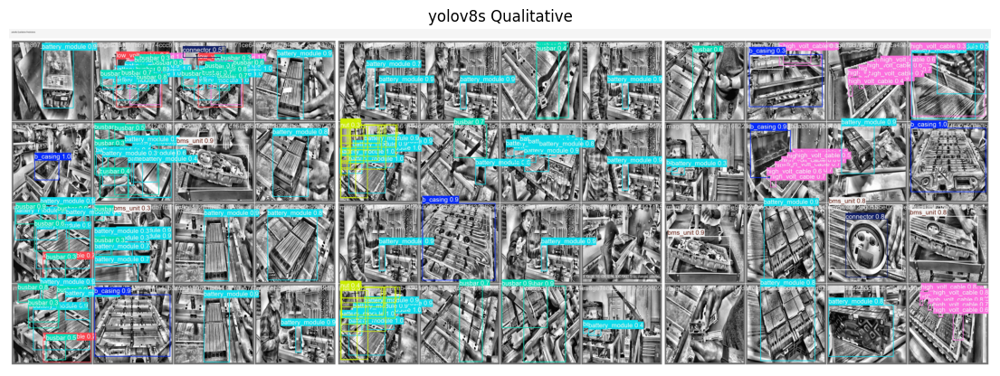

Saved: report_figures/yolov8/yolov8s/yolov8s_C_qualitative.png

=== yolov8m ===


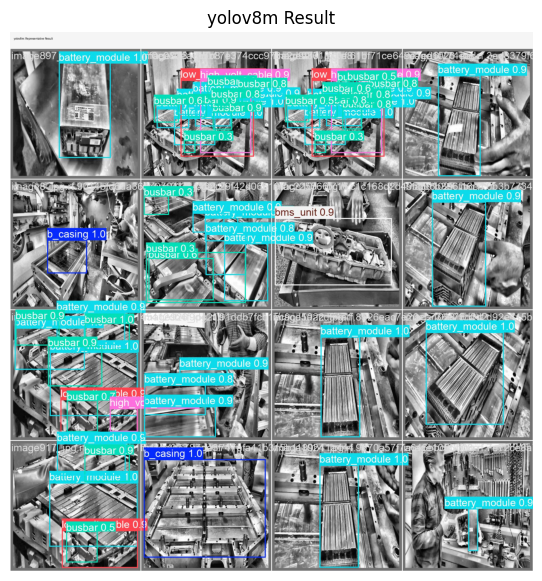

Saved: report_figures/yolov8/yolov8m/yolov8m_B_result.png


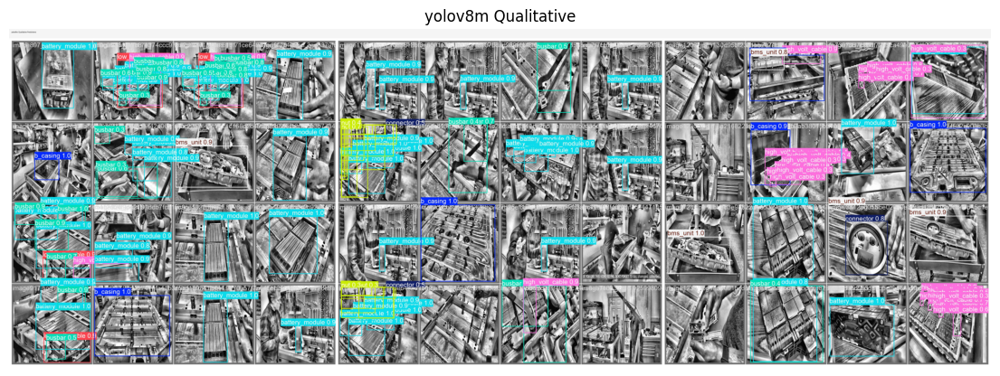

Saved: report_figures/yolov8/yolov8m/yolov8m_C_qualitative.png

=== yolov8l ===


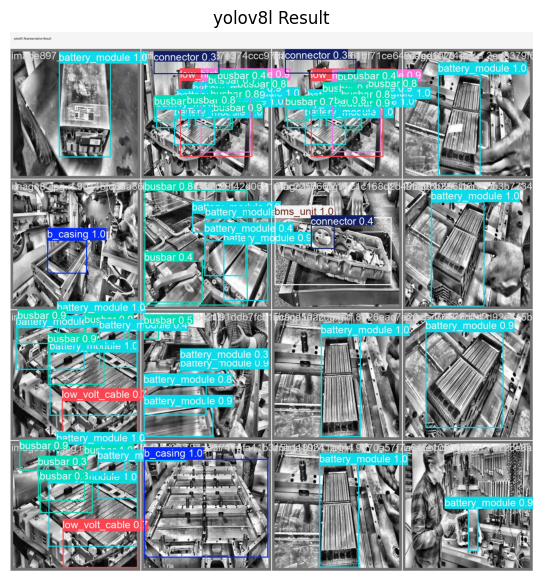

Saved: report_figures/yolov8/yolov8l/yolov8l_B_result.png


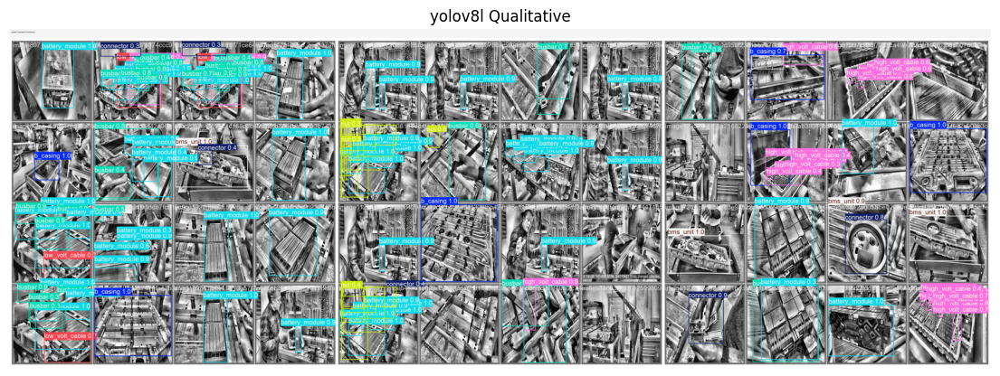

Saved: report_figures/yolov8/yolov8l/yolov8l_C_qualitative.png

=== yolov8x ===


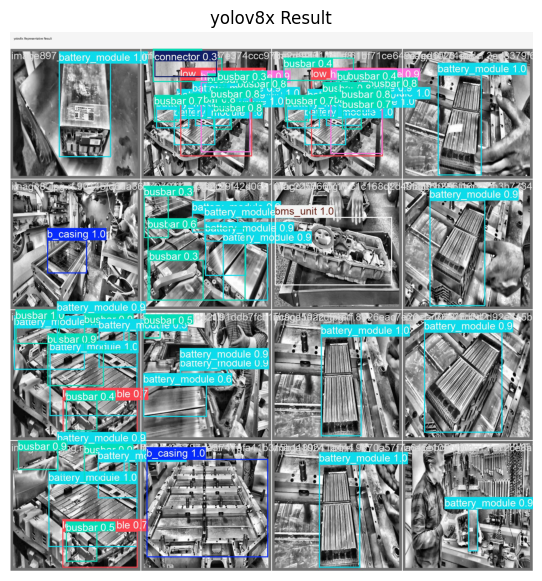

Saved: report_figures/yolov8/yolov8x/yolov8x_B_result.png


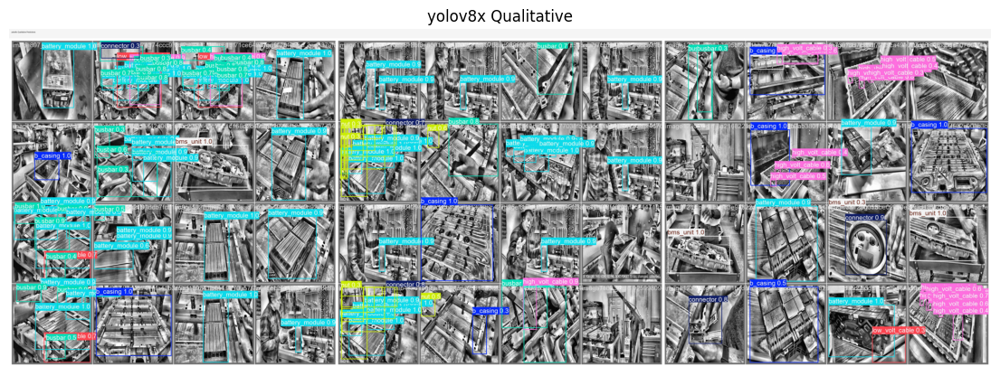

Saved: report_figures/yolov8/yolov8x/yolov8x_C_qualitative.png

DONE — all YOLOv8 figures generated.


In [4]:
from pathlib import Path
from PIL import Image, ImageDraw
import math
import matplotlib.pyplot as plt

# ============================
# CONFIG
# ============================
YOLOV8_RUNS = {
    "yolov8n": Path("runs/report_val/yolov8/yolov8n"),
    "yolov8s": Path("runs/report_val/yolov8/yolov8s"),
    "yolov8m": Path("runs/report_val/yolov8/yolov8m"),
    "yolov8l": Path("runs/report_val/yolov8/yolov8l"),
    "yolov8x": Path("runs/report_val/yolov8/yolov8x"),
}

OUT_ROOT = Path("report_figures/yolov8")
OUT_ROOT.mkdir(parents=True, exist_ok=True)

QUAL_N = 6
PAD = 14
TITLE_H = 60
BG = (255, 255, 255)
MAX_W = 2200

CURVE_FILES = ["P_curve.png", "R_curve.png", "F1_curve.png", "PR_curve.png"]
LABEL_FILES = ["labels.jpg", "labels.png", "labels_correlogram.jpg"]
CONF_FILES = ["confusion_matrix.png", "confusion_matrix_normalized.png"]
PRED_FILES = ["val_batch*_pred.jpg", "val_batch*_pred.png"]

# ============================
# HELPERS
# ============================
def load_img(p):
    return Image.open(p).convert("RGB")

def find_first(run_dir, patterns):
    for pat in patterns:
        files = list(run_dir.rglob(pat))
        if files:
            return files[0]
    return None

def find_all(run_dir, patterns):
    files = []
    for pat in patterns:
        files.extend(run_dir.rglob(pat))
    return sorted(set(files))

def add_title(img, title):
    w, h = img.size
    canvas = Image.new("RGB", (w, h + TITLE_H), BG)
    canvas.paste(img, (0, TITLE_H))
    draw = ImageDraw.Draw(canvas)
    draw.rectangle([0, 0, w, TITLE_H], fill=(245, 245, 245))
    draw.text((PAD, 18), title, fill=(0, 0, 0))
    return canvas

def resize_fit(img, max_w):
    if img.size[0] > max_w:
        scale = max_w / img.size[0]
        return img.resize((int(img.size[0]*scale), int(img.size[1]*scale)))
    return img

def tile(images, cols):
    rows = math.ceil(len(images)/cols)
    w = min(i.size[0] for i in images)
    resized = [i.resize((w, int(i.size[1]*w/i.size[0]))) for i in images]

    row_heights = [max(resized[i*cols+j].size[1]
        for j in range(min(cols, len(resized)-i*cols)))
        for i in range(rows)]

    out_w = cols*w + (cols+1)*PAD
    out_h = sum(row_heights) + (rows+1)*PAD
    canvas = Image.new("RGB", (out_w, out_h), BG)

    y = PAD
    idx = 0
    for r in range(rows):
        x = PAD
        for c in range(cols):
            if idx >= len(resized):
                break
            img = resized[idx]
            canvas.paste(img, (x, y))
            x += w + PAD
            idx += 1
        y += row_heights[r] + PAD
    return canvas

def hstack(images):
    h = min(i.size[1] for i in images)
    resized = [i.resize((int(i.size[0]*h/i.size[1]), h)) for i in images]
    out_w = sum(i.size[0] for i in resized) + (len(resized)+1)*PAD
    canvas = Image.new("RGB", (out_w, h + 2*PAD), BG)
    x = PAD
    for i in resized:
        canvas.paste(i, (x, PAD))
        x += i.size[0] + PAD
    return canvas

def vstack(images):
    w = min(i.size[0] for i in images)
    resized = [i.resize((w, int(i.size[1]*w/i.size[0]))) for i in images]
    out_h = sum(i.size[1] for i in resized) + (len(resized)+1)*PAD
    canvas = Image.new("RGB", (w + 2*PAD, out_h), BG)
    y = PAD
    for i in resized:
        canvas.paste(i, (PAD, y))
        y += i.size[1] + PAD
    return canvas

def save_show(img, path, title):
    img = resize_fit(img, MAX_W)
    img.save(path, quality=95)
    plt.figure(figsize=(14, 7))
    plt.imshow(img)
    plt.title(title)
    plt.axis("off")
    plt.show()
    print("Saved:", path)

# ============================
# PROCESS EACH YOLOv8 MODEL
# ============================
for name, run_dir in YOLOV8_RUNS.items():
    print(f"\n=== {name} ===")
    if not run_dir.exists():
        print("Missing:", run_dir)
        continue

    out = OUT_ROOT / name
    out.mkdir(parents=True, exist_ok=True)

    # ---- A: Diagnostics image
    curves = [load_img(p) for p in find_all(run_dir, CURVE_FILES)[:4]]
    curves_img = tile(curves, 2) if curves else None

    labels = find_first(run_dir, LABEL_FILES)
    conf = find_first(run_dir, CONF_FILES)
    bottom = hstack([load_img(labels), load_img(conf)]) if labels and conf else None

    if curves_img or bottom:
        diag = vstack([i for i in [curves_img, bottom] if i])
        diag = add_title(diag, f"{name}: Curves + Labels + Confusion")
        save_show(diag, out / f"{name}_A_diagnostics.png", f"{name} Diagnostics")

    # ---- B: Single result image
    preds = find_all(run_dir, PRED_FILES)
    if preds:
        img = add_title(load_img(preds[0]), f"{name}: Representative Result")
        save_show(img, out / f"{name}_B_result.png", f"{name} Result")

    # ---- C: Qualitative collage
    if preds:
        chosen = preds[:QUAL_N]
        qual = tile([load_img(p) for p in chosen], 3)
        qual = add_title(qual, f"{name}: Qualitative Predictions")
        save_show(qual, out / f"{name}_C_qualitative.png", f"{name} Qualitative")

print("\nDONE — all YOLOv8 figures generated.")



=== yolov8n ===


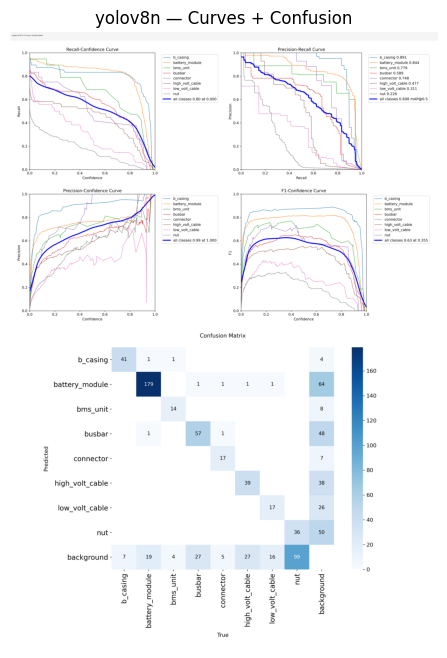

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov8/diagnostics_per_model/yolov8n_curves_confusion.png

=== yolov8s ===


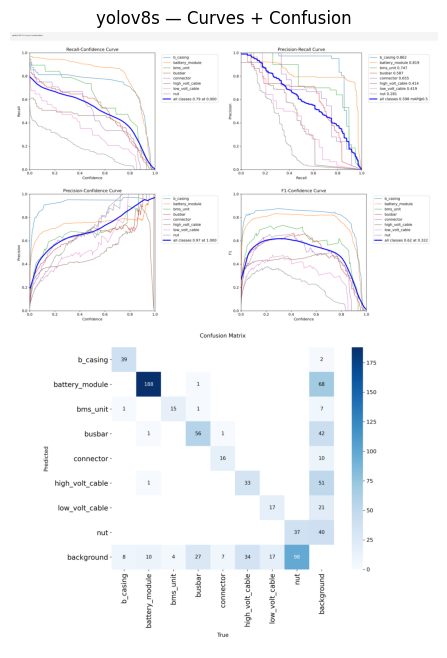

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov8/diagnostics_per_model/yolov8s_curves_confusion.png

=== yolov8m ===


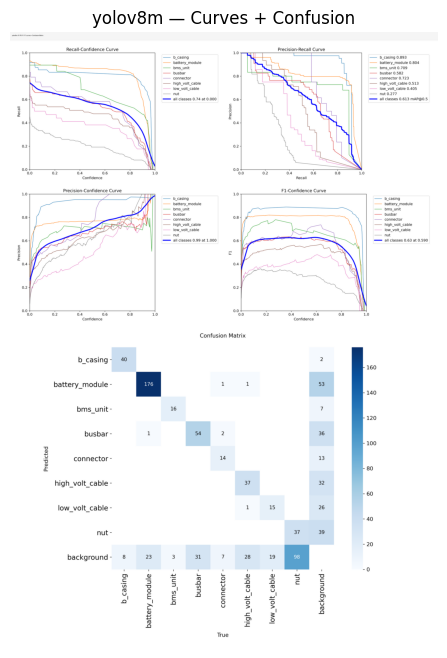

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov8/diagnostics_per_model/yolov8m_curves_confusion.png

=== yolov8l ===


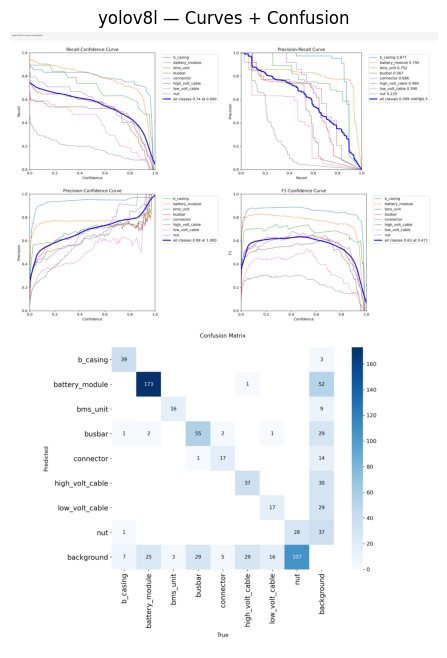

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov8/diagnostics_per_model/yolov8l_curves_confusion.png

=== yolov8x ===


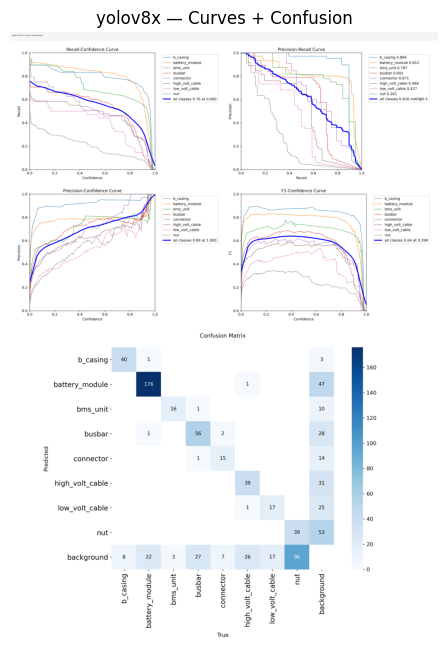

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov8/diagnostics_per_model/yolov8x_curves_confusion.png


In [6]:
from pathlib import Path
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import math

# ----------------------------
# CONFIG: update if your folders differ
# ----------------------------
YOLOV8_RUNS = {
    "yolov8n": Path("runs/report_val/yolov8/yolov8n"),
    "yolov8s": Path("runs/report_val/yolov8/yolov8s"),
    "yolov8m": Path("runs/report_val/yolov8/yolov8m"),
    "yolov8l": Path("runs/report_val/yolov8/yolov8l"),
    "yolov8x": Path("runs/report_val/yolov8/yolov8x"),
}

OUT_DIR = Path("report_figures/yolov8/diagnostics_per_model")
OUT_DIR.mkdir(parents=True, exist_ok=True)

SAVE = True
BG = (255, 255, 255)
PAD = 14
TITLE_H = 60
MAX_W = 2200

CURVE_FILES = ["BoxR_curve.png", "BoxPR_curve.png", "BoxP_curve.png", "BoxF1_curve.png"]
CONF_FILE = "confusion_matrix.png"

# ----------------------------
# Helpers
# ----------------------------
def find_file(run_dir: Path, filename: str):
    p = run_dir / filename
    if p.exists():
        return p
    matches = list(run_dir.rglob(filename))
    return matches[0] if matches else None

def load_img(p: Path):
    return Image.open(p).convert("RGB")

def resize_fit(img: Image.Image, max_w=MAX_W):
    w, h = img.size
    if w <= max_w:
        return img
    scale = max_w / w
    return img.resize((int(w * scale), int(h * scale)), Image.Resampling.LANCZOS)

def add_title(img: Image.Image, title: str):
    w, h = img.size
    canvas = Image.new("RGB", (w, h + TITLE_H), BG)
    canvas.paste(img, (0, TITLE_H))
    draw = ImageDraw.Draw(canvas)
    draw.rectangle([0, 0, w, TITLE_H], fill=(245, 245, 245))
    draw.text((PAD, 18), title, fill=(0, 0, 0))
    return canvas

def tile_2x2(imgs, pad=PAD):
    """imgs length must be 4; returns a 2x2 grid"""
    assert len(imgs) == 4

    # use smallest width to avoid upscaling
    w = min(im.size[0] for im in imgs)
    resized = [im.resize((w, int(im.size[1]*w/im.size[0])), Image.Resampling.LANCZOS) for im in imgs]

    row1, row2 = resized[:2], resized[2:]
    h1 = max(im.size[1] for im in row1)
    h2 = max(im.size[1] for im in row2)

    out_w = 2*w + 3*pad
    out_h = h1 + h2 + 3*pad
    canvas = Image.new("RGB", (out_w, out_h), BG)

    canvas.paste(row1[0], (pad, pad))
    canvas.paste(row1[1], (pad + w + pad, pad))

    y2 = pad + h1 + pad
    canvas.paste(row2[0], (pad, y2))
    canvas.paste(row2[1], (pad + w + pad, y2))

    return canvas

def vstack(top: Image.Image, bottom: Image.Image, pad=PAD):
    """Stack two images vertically, matching widths"""
    w = min(top.size[0], bottom.size[0])

    def fit_w(im):
        if im.size[0] == w:
            return im
        scale = w / im.size[0]
        return im.resize((w, int(im.size[1]*scale)), Image.Resampling.LANCZOS)

    top2 = fit_w(top)
    bottom2 = fit_w(bottom)

    out_w = w + 2*pad
    out_h = top2.size[1] + bottom2.size[1] + 3*pad
    canvas = Image.new("RGB", (out_w, out_h), BG)
    canvas.paste(top2, (pad, pad))
    canvas.paste(bottom2, (pad, pad + top2.size[1] + pad))
    return canvas

def show(img: Image.Image, title: str):
    img = resize_fit(img, MAX_W)
    plt.figure(figsize=(14, 8))
    plt.imshow(img)
    plt.title(title)
    plt.axis("off")
    plt.show()

# ----------------------------
# Build + display one composite per model
# ----------------------------
for model_name, run_dir in YOLOV8_RUNS.items():
    print(f"\n=== {model_name} ===")
    if not run_dir.exists():
        print(f"[SKIP] Folder not found: {run_dir}")
        continue

    # Locate curve files and confusion
    curve_paths = [find_file(run_dir, f) for f in CURVE_FILES]
    conf_path = find_file(run_dir, CONF_FILE)

    missing = [CURVE_FILES[i] for i,p in enumerate(curve_paths) if p is None]
    if conf_path is None:
        missing.append(CONF_FILE)

    if missing:
        print(f"[SKIP] Missing required files for {model_name}: {missing}")
        continue

    # Load images
    curve_imgs = [load_img(p) for p in curve_paths]
    conf_img = load_img(conf_path)

    # Compose: 2x2 grid of curves + confusion below
    curves_grid = tile_2x2(curve_imgs)
    composite = vstack(curves_grid, conf_img)
    composite = add_title(composite, f"{model_name}: R / PR / P / F1 curves + Confusion Matrix")

    # Display in notebook
    show(composite, f"{model_name} — Curves + Confusion")

    # Save composite
    if SAVE:
        out_path = OUT_DIR / f"{model_name}_curves_confusion.png"
        composite = resize_fit(composite, MAX_W)
        composite.save(out_path, quality=95)
        print(f"Saved: {out_path.resolve()}")



Evaluating yolov9t...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
YOLOv9t summary (fused): 203 layers, 1,731,384 parameters, 0 gradients, 6.4 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2679.3±665.5 MB/s, size: 57.1 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 145.6Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 5.4it/s 1.8s.2s
                   all        158        612      0.666       0.58      0.606      0.455
              b_casing         48         

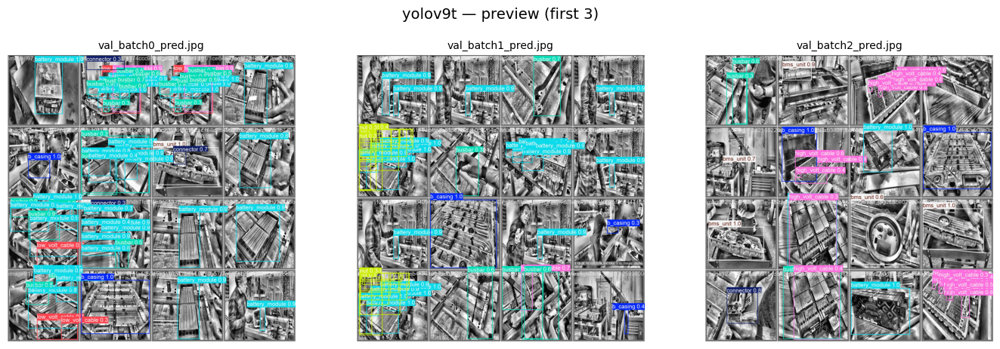


yolov9s: found 3 qualitative pred images in runs/report_val/yolov9/yolov9s


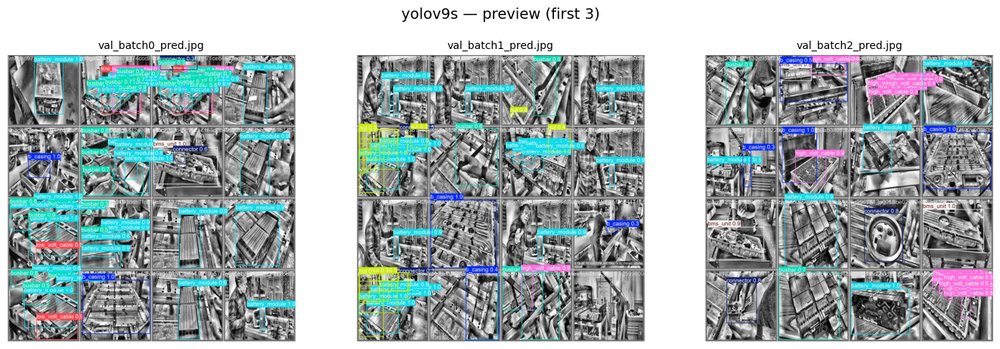


yolov9m: found 3 qualitative pred images in runs/report_val/yolov9/yolov9m


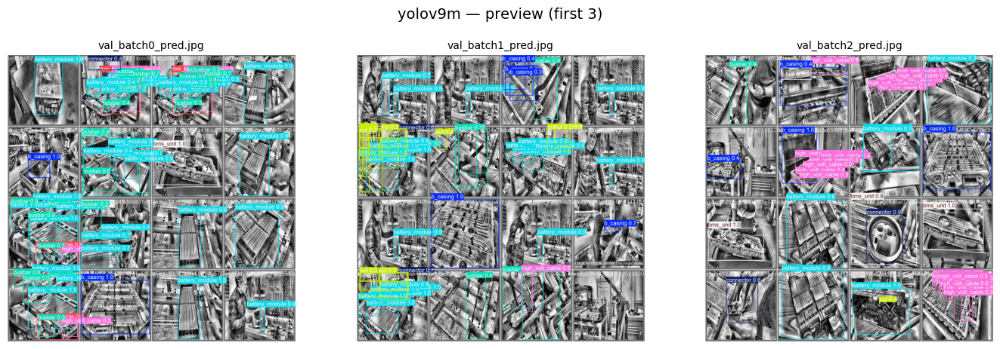


yolov9c: found 3 qualitative pred images in runs/report_val/yolov9/yolov9c


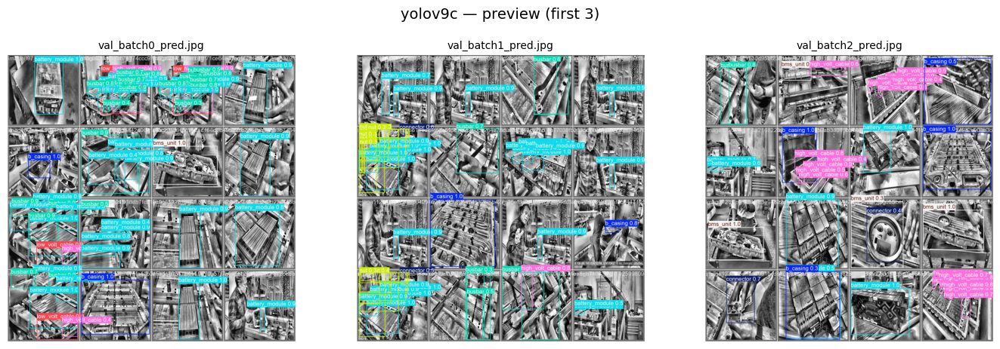


REPORT SHORTLIST (YOLOv9)
Selected 8 images total.



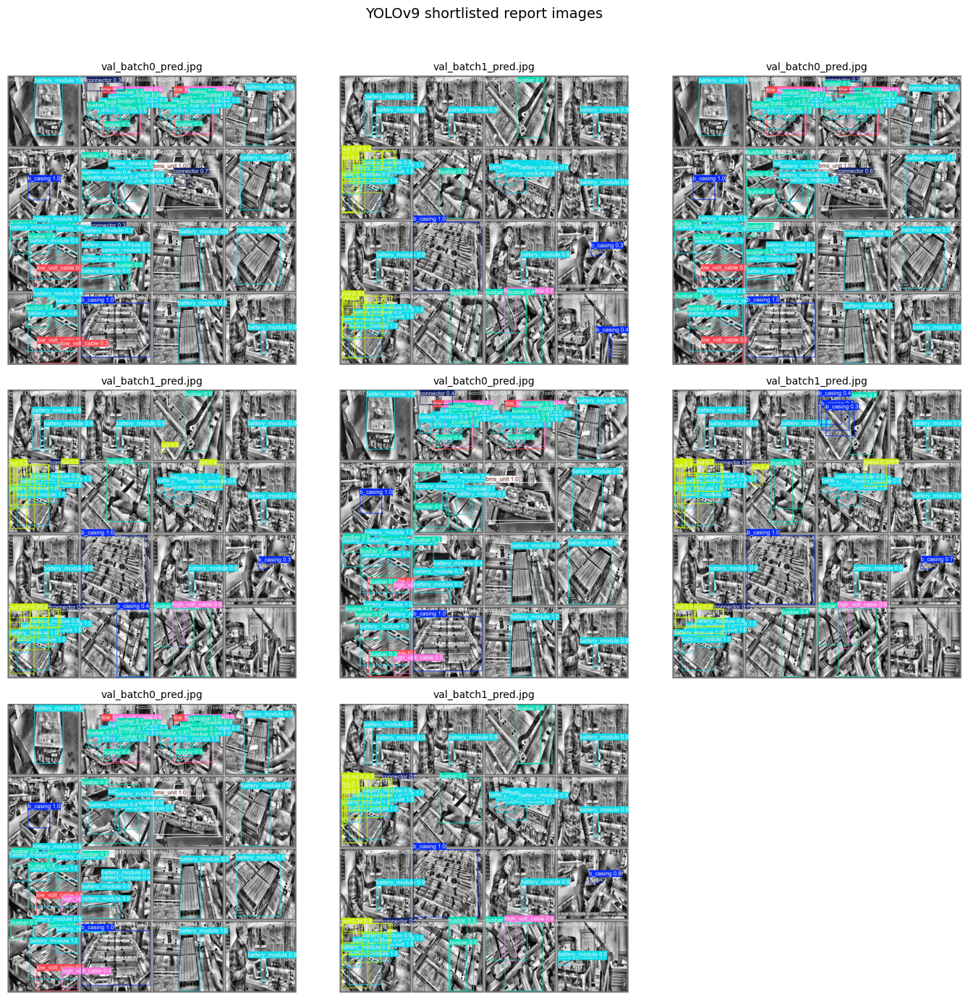

yolov9t: /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov9/yolov9t/val_batch0_pred.jpg
yolov9t: /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov9/yolov9t/val_batch1_pred.jpg
yolov9s: /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov9/yolov9s/val_batch0_pred.jpg
yolov9s: /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov9/yolov9s/val_batch1_pred.jpg
yolov9m: /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov9/yolov9m/val_batch0_pred.jpg
yolov9m: /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov9/yolov9m/val_batch1_pred.jpg
yolov9c: /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov9/yolov9c/val_batch0_pred.jpg
yolov9c: /home/250027044/ultralyticsWithEfficientNetB3/runs/report_val/yolov9/yolov9c/val_batch1_pred.jpg

Exported 8 images to: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov9
You can now use these directly in LaTeX: images/report_figure

In [11]:
import os
import shutil
from pathlib import Path
import math
import matplotlib.pyplot as plt
from PIL import Image
from ultralytics import YOLO

# ----------------------------
# CONFIG (YOLOv9)
# ----------------------------
MODELS = ["yolov9t", "yolov9s", "yolov9m", "yolov9c"]  # YOLOv9 variants you evaluated
DATA_YAML = "Ev-Battery-Components-3/data.yaml"
IMGSZ = 640
IOU = 0.7
CONF = 0.001

# Where your trained weights are (edit if your folder layout differs)
WEIGHTS_FMT = "runs/yolov9/{name}/weights/best.pt"

# Where to save each model's val predictions (deterministic folder per model)
OUT_ROOT = Path("runs/report_val/yolov9")
OUT_ROOT.mkdir(parents=True, exist_ok=True)

# Report figure export folder
EXPORT_DIR = Path("report_figures/yolov9")
EXPORT_DIR.mkdir(parents=True, exist_ok=True)

# Display settings
COLS = 3
FIG_W = 14
MAX_SHOW_PER_MODEL = 6    # preview first N images per model
TARGET_TOTAL_REPORT_IMAGES = 8  # e.g., 2 per model => 8 total (edit as needed)

# ----------------------------
# HELPERS
# ----------------------------
def open_img(p, max_size=(1600, 1600)):
    img = Image.open(p).convert("RGB")
    img.thumbnail(max_size)
    return img

def show_grid(paths, title="", cols=COLS):
    paths = list(paths)
    n = len(paths)
    if n == 0:
        print(f"[No images found] {title}")
        return
    rows = math.ceil(n / cols)
    plt.figure(figsize=(FIG_W, rows * 4.5))
    for i, p in enumerate(paths, 1):
        ax = plt.subplot(rows, cols, i)
        ax.imshow(open_img(p))
        ax.set_title(Path(p).name, fontsize=10)
        ax.axis("off")
    plt.suptitle(title, fontsize=14, y=1.02)
    plt.tight_layout()
    plt.show()

def find_val_pred_images(run_dir: Path):
    # Ultralytics typically writes val_batch*_pred.* in the val output directory
    patterns = ["val_batch*_pred.jpg", "val_batch*_pred.png"]
    imgs = []
    for pat in patterns:
        imgs.extend(sorted(run_dir.glob(pat)))
    return imgs

def safe_copy(src: Path, dst: Path):
    dst.parent.mkdir(parents=True, exist_ok=True)
    shutil.copy2(src, dst)

# ----------------------------
# 1) RUN VALIDATION AND SAVE PRED IMAGES (OPTIONAL)
# ----------------------------
# If you ALREADY have val folders with images, set RUN_VAL=False and manually set val_runs mapping.
RUN_VAL = True

val_runs = {}  # model_name -> output_dir

if RUN_VAL:
    for name in MODELS:
        weights_path = Path(WEIGHTS_FMT.format(name=name))
        print(f"\nEvaluating {name}...")
        if not weights_path.exists():
            print(f"  [SKIP] Missing weights: {weights_path}")
            continue

        model = YOLO(str(weights_path))

        # Force deterministic output directory per model:
        metrics = model.val(
            data=DATA_YAML,
            imgsz=IMGSZ,
            iou=IOU,
            conf=CONF,
            project=str(OUT_ROOT),
            name=name,
            exist_ok=True,
            save=True,        # saves val_batch*_pred.*
            save_txt=False,
            plots=True        # saves curves + confusion matrix
        )

        out_dir = OUT_ROOT / name
        val_runs[name] = out_dir
        print(f"  Saved outputs to: {out_dir.resolve()}")

else:
    # If you want to point to existing Ultralytics val folders, do something like:
    # val_runs = {
    #     "yolov9t": Path("runs/detect/val88"),
    #     "yolov9s": Path("runs/detect/val89"),
    #     "yolov9m": Path("runs/detect/val90"),
    #     "yolov9c": Path("runs/detect/val91"),
    # }
    pass

# ----------------------------
# 2) PREVIEW AVAILABLE QUALITATIVE IMAGES PER MODEL
# ----------------------------
all_model_images = {}
for name in MODELS:
    run_dir = val_runs.get(name, None)
    if run_dir is None or not run_dir.exists():
        continue
    imgs = find_val_pred_images(run_dir)
    all_model_images[name] = imgs

    print(f"\n{name}: found {len(imgs)} qualitative pred images in {run_dir}")
    show_grid(imgs[:MAX_SHOW_PER_MODEL], title=f"{name} — preview (first {min(MAX_SHOW_PER_MODEL, len(imgs))})")

# ----------------------------
# 3) SELECT IMAGES FOR THE PAPER
# ----------------------------
# Default picks: first two per model (edit after preview)
PICKS = {
    "yolov9t": [0, 1],
    "yolov9s": [0, 1],
    "yolov9m": [0, 1],
    "yolov9c": [0, 1],
}

selected = []
for name, idxs in PICKS.items():
    imgs = all_model_images.get(name, [])
    for idx in idxs:
        if 0 <= idx < len(imgs):
            selected.append((name, imgs[idx]))

# Trim to your target (e.g., 8 images total)
selected = selected[:TARGET_TOTAL_REPORT_IMAGES]

print("\n==============================")
print("REPORT SHORTLIST (YOLOv9)")
print("==============================")
print(f"Selected {len(selected)} images total.\n")

# Display shortlist in a grid
show_grid([p for _, p in selected], title="YOLOv9 shortlisted report images", cols=COLS)

# Print full paths
for name, p in selected:
    print(f"{name}: {p.resolve()}")

# ----------------------------
# 4) EXPORT SELECTED IMAGES INTO report_figures/yolov9/
# ----------------------------
for i, (name, src) in enumerate(selected, 1):
    dst = EXPORT_DIR / f"{i:02d}_{name}_{src.name}"
    safe_copy(Path(src), dst)

print(f"\nExported {len(selected)} images to: {EXPORT_DIR.resolve()}")
print("You can now use these directly in LaTeX: images/report_figures/yolov9/...")


In [1]:
import os
import shutil
from pathlib import Path
import math
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from ultralytics import YOLO

# ----------------------------
# CONFIG
# ----------------------------
v9_inner_results = []

models = ["yolov9t.yaml", "yolov9s.yaml", "yolov9m.yaml", "yolov9c.yaml"]
data_yaml_path = "Ev-Battery-Components-3/data.yaml"

# Your weights layout (keep as-is if correct)
WEIGHTS_FMT = "runs/yolov9inner/ultralytics/cfg/models/v9/{name}/weights/best.pt"

# Where to SAVE outputs (pred images + plots) in a clean deterministic structure
OUT_ROOT = Path("runs/report_val/yolov9inner")
OUT_ROOT.mkdir(parents=True, exist_ok=True)

# Where to export selected images for your report
EXPORT_DIR = Path("report_figures/yolov9inner")
EXPORT_DIR.mkdir(parents=True, exist_ok=True)

# Display settings
COLS = 3
FIG_W = 14
MAX_SHOW_PER_MODEL = 6

# ----------------------------
# HELPERS
# ----------------------------
def open_img(p, max_size=(1600, 1600)):
    img = Image.open(p).convert("RGB")
    img.thumbnail(max_size)
    return img

def show_grid(paths, title="", cols=COLS):
    paths = list(paths)
    n = len(paths)
    if n == 0:
        print(f"[No images found] {title}")
        return
    rows = math.ceil(n / cols)
    plt.figure(figsize=(FIG_W, rows * 4.5))
    for i, p in enumerate(paths, 1):
        ax = plt.subplot(rows, cols, i)
        ax.imshow(open_img(p))
        ax.set_title(Path(p).name, fontsize=10)
        ax.axis("off")
    plt.suptitle(title, fontsize=14, y=1.02)
    plt.tight_layout()
    plt.show()

def find_val_pred_images(run_dir: Path):
    patterns = ["val_batch*_pred.jpg", "val_batch*_pred.png"]
    imgs = []
    for pat in patterns:
        imgs.extend(sorted(run_dir.glob(pat)))
    return imgs

# ----------------------------
# RUN + SAVE + DISPLAY
# ----------------------------
val_runs = {}  # model_stem -> output dir

for name in models:
    model_stem = Path(name).stem  # yolov9t, yolov9s, ...
    weights_path = WEIGHTS_FMT.format(name=name)

    print(f"\nEvaluating {name} ({model_stem})...")
    if not os.path.exists(weights_path):
        v9_inner_results.append({"Model": name, "Error": "best.pt missing"})
        print(f"  [SKIP] Missing weights: {weights_path}")
        continue

    model = YOLO(weights_path)

    # IMPORTANT: project/name makes a deterministic output folder:
    # runs/report_val/yolov9inner/yolov9t/  etc.
    metrics = model.val(
        data=data_yaml_path,
        imgsz=640,
        iou=0.7,
        conf=0.001,
        project=str(OUT_ROOT),
        name=model_stem,
        exist_ok=True,
        save=True,      # saves val_batch*_pred.*
        plots=True      # saves curves + confusion matrix
    )

    out_dir = OUT_ROOT / model_stem
    val_runs[model_stem] = out_dir
    print(f"  Saved outputs to: {out_dir.resolve()}")

    v9_inner_results.append({
        "Model": model_stem,
        "mAP50-95": metrics.box.map,
        "mAP50": metrics.box.map50,
        "Precision": metrics.box.mp,
        "Recall": metrics.box.mr,
    })

    # ---- Display qualitative predictions
    pred_imgs = find_val_pred_images(out_dir)
    print(f"  Found {len(pred_imgs)} prediction images.")
    show_grid(pred_imgs[:MAX_SHOW_PER_MODEL], title=f"{model_stem} — predictions preview")

# Display metrics table
df = pd.DataFrame(v9_inner_results)
display(df)

print("\nDone.")
print("Per-model outputs are saved under:")
for k, v in val_runs.items():
    print(f" - {k}: {v}")



Evaluating yolov9t.yaml (yolov9t)...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
YOLOv9t summary (fused): 203 layers, 1,731,384 parameters, 0 gradients, 6.4 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2626.4±571.1 MB/s, size: 55.2 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 189.5Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 5.0it/s 2.0s.2s
                   all        158        612      0.525      0.554      0.495      0.344
              b_casing     

<Figure size 1400x450 with 3 Axes>


Evaluating yolov9s.yaml (yolov9s)...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
YOLOv9s summary (fused): 203 layers, 6,196,744 parameters, 0 gradients, 22.1 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2700.5±513.6 MB/s, size: 62.3 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 197.0Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 4.9it/s 2.0s.3s
                   all        158        612      0.594      0.604      0.578      0.399
              b_casing    

<Figure size 1400x450 with 3 Axes>


Evaluating yolov9m.yaml (yolov9m)...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
YOLOv9m summary (fused): 157 layers, 16,580,776 parameters, 0 gradients, 60.0 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2404.1±728.4 MB/s, size: 60.8 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 192.8Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 4.2it/s 2.4s.2s
                   all        158        612      0.604      0.586      0.574      0.413
              b_casing   

<Figure size 1400x450 with 3 Axes>


Evaluating yolov9c.yaml (yolov9c)...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
YOLOv9c summary (fused): 162 layers, 21,151,592 parameters, 0 gradients, 82.7 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2673.2±522.0 MB/s, size: 64.0 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 309.0Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 3.9it/s 2.5s.2ss
                   all        158        612      0.644      0.564      0.584      0.425
              b_casing  

<Figure size 1400x450 with 3 Axes>

,Model,mAP50-95,mAP50,Precision,Recall
0,yolov9t,0.344054,0.494770,0.525228,0.554228
1,yolov9s,0.398697,0.577724,0.594210,0.604007
2,yolov9m,0.413190,0.573728,0.604499,0.585703
3,yolov9c,0.424525,0.584311,0.643622,0.564279



Done.
Per-model outputs are saved under:
 - yolov9t: runs/report_val/yolov9inner/yolov9t
 - yolov9s: runs/report_val/yolov9inner/yolov9s
 - yolov9m: runs/report_val/yolov9inner/yolov9m
 - yolov9c: runs/report_val/yolov9inner/yolov9c



=== yolov9t ===


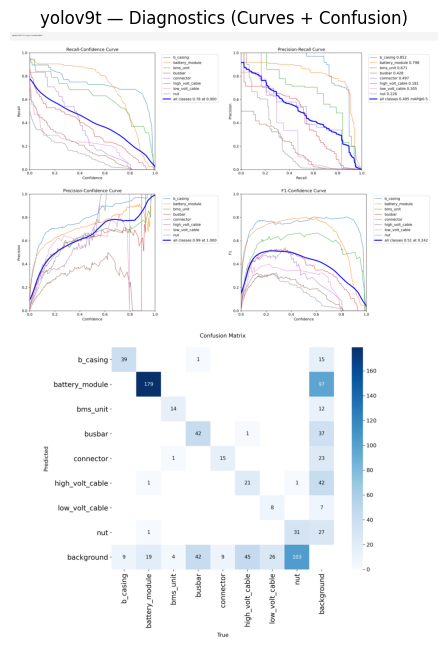

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov9inner/diagnostics_per_model/yolov9t_curves_confusion.png

=== yolov9s ===


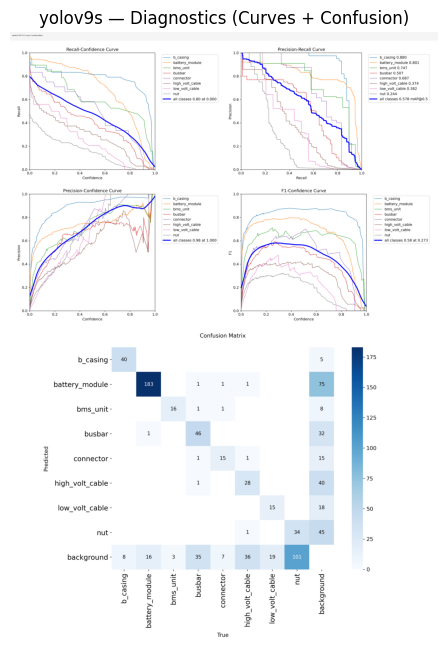

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov9inner/diagnostics_per_model/yolov9s_curves_confusion.png

=== yolov9m ===


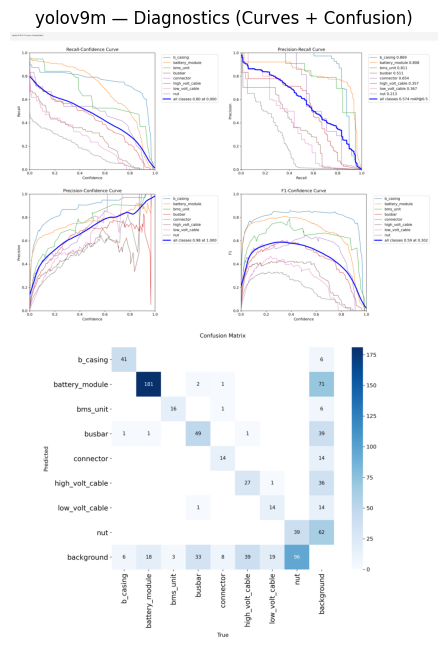

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov9inner/diagnostics_per_model/yolov9m_curves_confusion.png

=== yolov9c ===


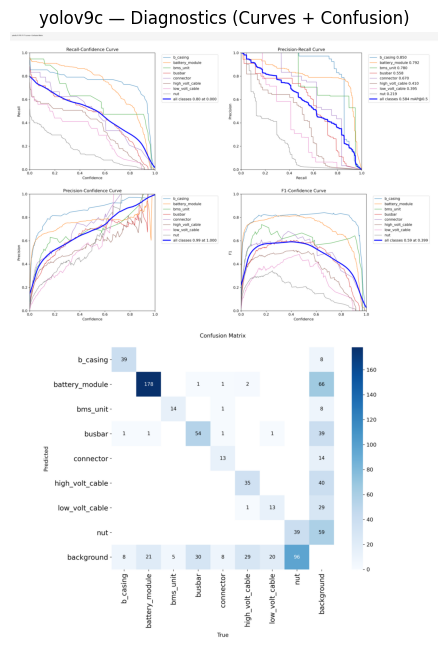

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov9inner/diagnostics_per_model/yolov9c_curves_confusion.png

DONE — diagnostics composites created.


In [2]:
from pathlib import Path
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt

# ----------------------------
# CONFIG
# ----------------------------
YOLOV9_DIR = Path("runs/report_val/yolov9inner")
MODELS = ["yolov9t", "yolov9s", "yolov9m", "yolov9c"]

OUT_DIR = Path("report_figures/yolov9inner/diagnostics_per_model")
OUT_DIR.mkdir(parents=True, exist_ok=True)

CURVE_FILES = ["BoxR_curve.png", "BoxPR_curve.png", "BoxP_curve.png", "BoxF1_curve.png"]
CONF_FILE = "confusion_matrix.png"

BG = (255, 255, 255)
PAD = 14
TITLE_H = 60
MAX_W = 2200

# ----------------------------
# HELPERS
# ----------------------------
def load_img(p: Path):
    return Image.open(p).convert("RGB")

def resize_fit(img: Image.Image, max_w=MAX_W):
    w, h = img.size
    if w <= max_w:
        return img
    scale = max_w / w
    return img.resize((int(w * scale), int(h * scale)), Image.Resampling.LANCZOS)

def add_title(img: Image.Image, title: str):
    w, h = img.size
    canvas = Image.new("RGB", (w, h + TITLE_H), BG)
    canvas.paste(img, (0, TITLE_H))
    draw = ImageDraw.Draw(canvas)
    draw.rectangle([0, 0, w, TITLE_H], fill=(245, 245, 245))
    draw.text((PAD, 18), title, fill=(0, 0, 0))
    return canvas

def tile_2x2(imgs):
    """imgs length must be 4"""
    w = min(im.size[0] for im in imgs)
    resized = [im.resize((w, int(im.size[1]*w/im.size[0])), Image.Resampling.LANCZOS) for im in imgs]

    row1, row2 = resized[:2], resized[2:]
    h1 = max(im.size[1] for im in row1)
    h2 = max(im.size[1] for im in row2)

    out_w = 2*w + 3*PAD
    out_h = h1 + h2 + 3*PAD
    canvas = Image.new("RGB", (out_w, out_h), BG)

    canvas.paste(row1[0], (PAD, PAD))
    canvas.paste(row1[1], (PAD + w + PAD, PAD))
    y2 = PAD + h1 + PAD
    canvas.paste(row2[0], (PAD, y2))
    canvas.paste(row2[1], (PAD + w + PAD, y2))
    return canvas

def vstack(top, bottom):
    w = min(top.size[0], bottom.size[0])

    def fit_w(im):
        if im.size[0] == w:
            return im
        scale = w / im.size[0]
        return im.resize((w, int(im.size[1]*scale)), Image.Resampling.LANCZOS)

    top2 = fit_w(top)
    bottom2 = fit_w(bottom)

    out_w = w + 2*PAD
    out_h = top2.size[1] + bottom2.size[1] + 3*PAD
    canvas = Image.new("RGB", (out_w, out_h), BG)
    canvas.paste(top2, (PAD, PAD))
    canvas.paste(bottom2, (PAD, PAD + top2.size[1] + PAD))
    return canvas

def show(img, title):
    img = resize_fit(img)
    plt.figure(figsize=(14, 8))
    plt.imshow(img)
    plt.title(title)
    plt.axis("off")
    plt.show()

# ----------------------------
# BUILD + DISPLAY + SAVE
# ----------------------------
for m in MODELS:
    run_dir = YOLOV9_DIR / m
    print(f"\n=== {m} ===")

    missing = []
    curve_paths = []
    for f in CURVE_FILES:
        p = run_dir / f
        if not p.exists():
            missing.append(f)
        else:
            curve_paths.append(p)

    conf_path = run_dir / CONF_FILE
    if not conf_path.exists():
        missing.append(CONF_FILE)

    if missing:
        print(f"[SKIP] Missing files in {run_dir}: {missing}")
        continue

    curve_imgs = [load_img(p) for p in curve_paths]
    conf_img = load_img(conf_path)

    curves_grid = tile_2x2(curve_imgs)
    composite = vstack(curves_grid, conf_img)
    composite = add_title(composite, f"{m}: R / PR / P / F1 curves + Confusion Matrix")

    show(composite, f"{m} — Diagnostics (Curves + Confusion)")

    out_path = OUT_DIR / f"{m}_curves_confusion.png"
    composite = resize_fit(composite)
    composite.save(out_path, quality=95)
    print(f"Saved: {out_path.resolve()}")

print("\nDONE — diagnostics composites created.")



=== yolov9t ===


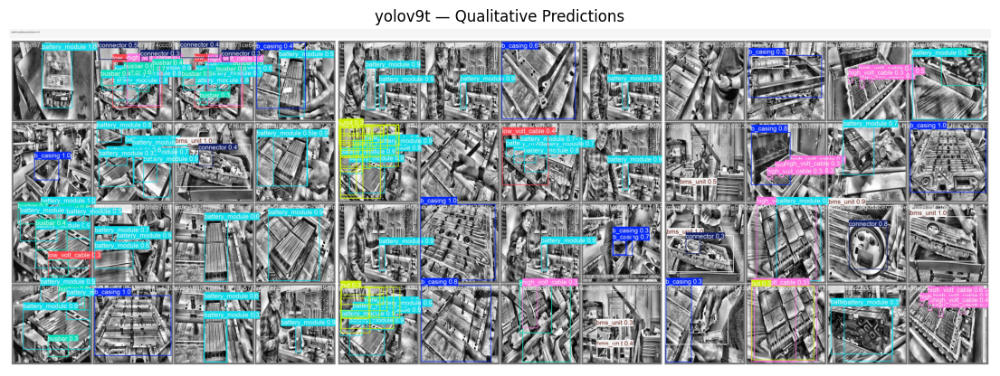

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov9inner/qualitative_per_model/yolov9t_qualitative_grid.png

=== yolov9s ===


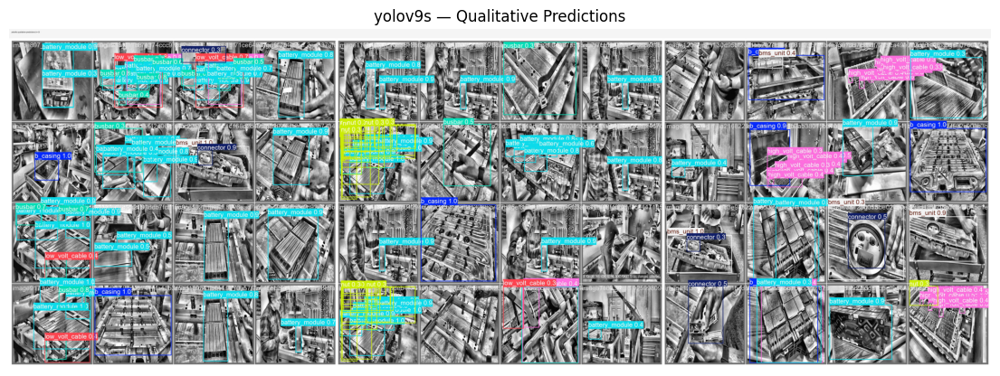

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov9inner/qualitative_per_model/yolov9s_qualitative_grid.png

=== yolov9m ===


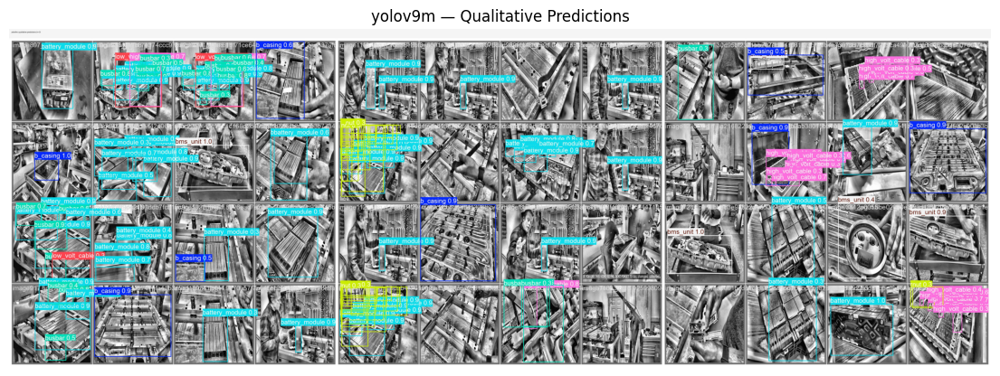

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov9inner/qualitative_per_model/yolov9m_qualitative_grid.png

=== yolov9c ===


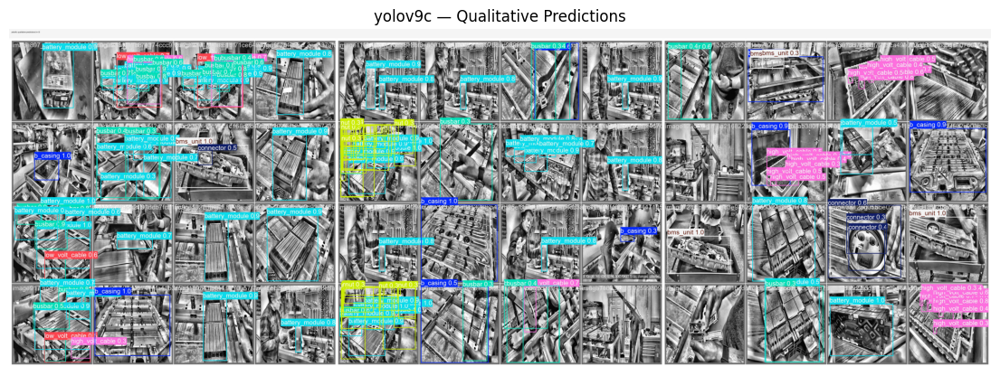

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov9inner/qualitative_per_model/yolov9c_qualitative_grid.png

DONE — qualitative grids created.


In [3]:
from pathlib import Path
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import math

YOLOV9_DIR = Path("runs/report_val/yolov9inner")
MODELS = ["yolov9t", "yolov9s", "yolov9m", "yolov9c"]

OUT_DIR = Path("report_figures/yolov9inner/qualitative_per_model")
OUT_DIR.mkdir(parents=True, exist_ok=True)

PRED_PATTERNS = ["val_batch*_pred.jpg", "val_batch*_pred.png"]
N_IMAGES = 6   # how many predictions to tile per model
COLS = 3

BG = (255, 255, 255)
PAD = 14
TITLE_H = 60
MAX_W = 2200

def load_img(p: Path):
    return Image.open(p).convert("RGB")

def resize_fit(img: Image.Image, max_w=MAX_W):
    w, h = img.size
    if w <= max_w:
        return img
    scale = max_w / w
    return img.resize((int(w * scale), int(h * scale)), Image.Resampling.LANCZOS)

def add_title(img: Image.Image, title: str):
    w, h = img.size
    canvas = Image.new("RGB", (w, h + TITLE_H), BG)
    canvas.paste(img, (0, TITLE_H))
    draw = ImageDraw.Draw(canvas)
    draw.rectangle([0, 0, w, TITLE_H], fill=(245, 245, 245))
    draw.text((PAD, 18), title, fill=(0, 0, 0))
    return canvas

def tile(images, cols=COLS):
    rows = math.ceil(len(images)/cols)
    w = min(i.size[0] for i in images)
    resized = [i.resize((w, int(i.size[1]*w/i.size[0])), Image.Resampling.LANCZOS) for i in images]

    row_heights = []
    for r in range(rows):
        row = resized[r*cols:(r+1)*cols]
        row_heights.append(max(im.size[1] for im in row))

    out_w = cols*w + (cols+1)*PAD
    out_h = sum(row_heights) + (rows+1)*PAD
    canvas = Image.new("RGB", (out_w, out_h), BG)

    y = PAD
    idx = 0
    for r in range(rows):
        x = PAD
        for c in range(cols):
            if idx >= len(resized):
                break
            canvas.paste(resized[idx], (x, y))
            x += w + PAD
            idx += 1
        y += row_heights[r] + PAD
    return canvas

def show(img, title):
    img = resize_fit(img)
    plt.figure(figsize=(14, 8))
    plt.imshow(img)
    plt.title(title)
    plt.axis("off")
    plt.show()

for m in MODELS:
    run_dir = YOLOV9_DIR / m
    print(f"\n=== {m} ===")

    pred_paths = []
    for pat in PRED_PATTERNS:
        pred_paths.extend(sorted(run_dir.glob(pat)))
    pred_paths = pred_paths[:N_IMAGES]

    if not pred_paths:
        print(f"[SKIP] No prediction images found in {run_dir}.")
        continue

    imgs = [load_img(p) for p in pred_paths]
    grid = tile(imgs, cols=COLS)
    grid = add_title(grid, f"{m}: qualitative predictions (n={len(pred_paths)})")

    show(grid, f"{m} — Qualitative Predictions")

    out_path = OUT_DIR / f"{m}_qualitative_grid.png"
    grid = resize_fit(grid)
    grid.save(out_path, quality=95)
    print(f"Saved: {out_path.resolve()}")

print("\nDONE — qualitative grids created.")



Evaluating yolov8n.yaml (yolov8n)...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
YOLOv8n summary (fused): 78 layers, 2,685,928 parameters, 0 gradients, 6.8 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2681.1±640.6 MB/s, size: 60.1 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 183.5Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 5.5it/s 1.8s0.2s
                   all        158        612      0.557      0.588      0.544      0.359
              b_casing     

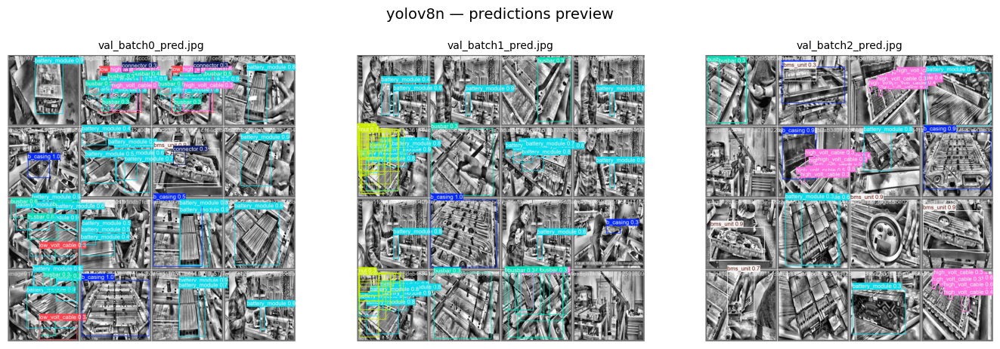


Evaluating yolov8s.yaml (yolov8s)...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
YOLOv8s summary (fused): 78 layers, 9,830,760 parameters, 0 gradients, 23.4 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2390.8±499.5 MB/s, size: 48.5 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 151.8Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 20% ━━────────── 2/10 1.4it/s 0.8s<5.8s

In [ ]:
import os
import pandas as pd
import math
import matplotlib.pyplot as plt
from pathlib import Path
from PIL import Image
from ultralytics import YOLO

# =========================================================
# YOLOv8inner: run val with save=True, plots=True, and show images
# Creates deterministic folders:
#   runs/report_val/yolov8inner/yolov8n/
#   runs/report_val/yolov8inner/yolov8s/
#   ...
# =========================================================

v8_inner_results = []

models = ["yolov8n.yaml", "yolov8s.yaml", "yolov8m.yaml", "yolov8l.yaml", "yolov8x.yaml"]
data_yaml_path = "Ev-Battery-Components-3/data.yaml"

# Your weights layout (keep as-is if correct)
WEIGHTS_FMT = "runs/yolov8inner/ultralytics/cfg/models/v8/{name}/weights/best.pt"

# Where to SAVE outputs (pred images + plots) in a clean deterministic structure
OUT_ROOT = Path("runs/report_val/yolov8inner")
OUT_ROOT.mkdir(parents=True, exist_ok=True)

# Basic preview settings
COLS = 3
FIG_W = 14
MAX_SHOW_PER_MODEL = 6

# ----------------------------
# HELPERS
# ----------------------------
def open_img(p, max_size=(1600, 1600)):
    img = Image.open(p).convert("RGB")
    img.thumbnail(max_size)
    return img

def show_grid(paths, title="", cols=COLS):
    paths = list(paths)
    n = len(paths)
    if n == 0:
        print(f"[No images found] {title}")
        return
    rows = math.ceil(n / cols)
    plt.figure(figsize=(FIG_W, rows * 4.5))
    for i, p in enumerate(paths, 1):
        ax = plt.subplot(rows, cols, i)
        ax.imshow(open_img(p))
        ax.set_title(Path(p).name, fontsize=10)
        ax.axis("off")
    plt.suptitle(title, fontsize=14, y=1.02)
    plt.tight_layout()
    plt.show()

def find_val_pred_images(run_dir: Path):
    patterns = ["val_batch*_pred.jpg", "val_batch*_pred.png"]
    imgs = []
    for pat in patterns:
        imgs.extend(sorted(run_dir.glob(pat)))
    return imgs

# ----------------------------
# RUN + SAVE + DISPLAY
# ----------------------------
val_runs = {}  # model_stem -> output dir

for name in models:
    model_stem = Path(name).stem  # yolov8n, yolov8s, ...
    weights_path = WEIGHTS_FMT.format(name=name)

    print(f"\nEvaluating {name} ({model_stem})...")
    if not os.path.exists(weights_path):
        v8_inner_results.append({"Model": name, "Error": "best.pt missing"})
        print(f"  [SKIP] Missing weights: {weights_path}")
        continue

    model = YOLO(weights_path)

    metrics = model.val(
        data=data_yaml_path,
        imgsz=640,
        iou=0.7,
        conf=0.001,
        project=str(OUT_ROOT),
        name=model_stem,
        exist_ok=True,
        save=True,     # saves val_batch*_pred.*
        plots=True     # saves curves + confusion matrix
    )

    out_dir = OUT_ROOT / model_stem
    val_runs[model_stem] = out_dir
    print(f"  Saved outputs to: {out_dir.resolve()}")

    v8_inner_results.append({
        "Model": model_stem,
        "mAP50-95": metrics.box.map,
        "mAP50": metrics.box.map50,
        "Precision": metrics.box.mp,
        "Recall": metrics.box.mr,
    })

    # Display qualitative predictions preview
    pred_imgs = find_val_pred_images(out_dir)
    print(f"  Found {len(pred_imgs)} prediction images.")
    show_grid(pred_imgs[:MAX_SHOW_PER_MODEL], title=f"{model_stem} — predictions preview")

# Display metrics table
df = pd.DataFrame(v8_inner_results)
display(df)

print("\nDone.")
print("Per-model outputs are saved under:")
for k, v in val_runs.items():
    print(f" - {k}: {v}")


In [1]:
import os
import pandas as pd
import math
import matplotlib.pyplot as plt
from pathlib import Path
from PIL import Image
from ultralytics import YOLO

# =========================================================
# YOLOv8inner: run val with save=True, plots=True, and show images
# Creates deterministic folders:
#   runs/report_val/yolov8inner/yolov8n/
#   runs/report_val/yolov8inner/yolov8s/
#   ...
# =========================================================

v8_inner_results = []

models = ["yolov8n.yaml", "yolov8s.yaml", "yolov8m.yaml", "yolov8l.yaml", "yolov8x.yaml"]
data_yaml_path = "Ev-Battery-Components-3/data.yaml"

# Your weights layout (keep as-is if correct)
WEIGHTS_FMT = "runs/yolov8inner/ultralytics/cfg/models/v8/{name}/weights/best.pt"

# Where to SAVE outputs (pred images + plots) in a clean deterministic structure
OUT_ROOT = Path("runs/report_val/yolov8inner")
OUT_ROOT.mkdir(parents=True, exist_ok=True)

# Basic preview settings
COLS = 3
FIG_W = 14
MAX_SHOW_PER_MODEL = 6

# ----------------------------
# HELPERS
# ----------------------------
def open_img(p, max_size=(1600, 1600)):
    img = Image.open(p).convert("RGB")
    img.thumbnail(max_size)
    return img

def show_grid(paths, title="", cols=COLS):
    paths = list(paths)
    n = len(paths)
    if n == 0:
        print(f"[No images found] {title}")
        return
    rows = math.ceil(n / cols)
    plt.figure(figsize=(FIG_W, rows * 4.5))
    for i, p in enumerate(paths, 1):
        ax = plt.subplot(rows, cols, i)
        ax.imshow(open_img(p))
        ax.set_title(Path(p).name, fontsize=10)
        ax.axis("off")
    plt.suptitle(title, fontsize=14, y=1.02)
    plt.tight_layout()
    plt.show()

def find_val_pred_images(run_dir: Path):
    patterns = ["val_batch*_pred.jpg", "val_batch*_pred.png"]
    imgs = []
    for pat in patterns:
        imgs.extend(sorted(run_dir.glob(pat)))
    return imgs

# ----------------------------
# RUN + SAVE + DISPLAY
# ----------------------------
val_runs = {}  # model_stem -> output dir

for name in models:
    model_stem = Path(name).stem  # yolov8n, yolov8s, ...
    weights_path = WEIGHTS_FMT.format(name=name)

    print(f"\nEvaluating {name} ({model_stem})...")
    if not os.path.exists(weights_path):
        v8_inner_results.append({"Model": name, "Error": "best.pt missing"})
        print(f"  [SKIP] Missing weights: {weights_path}")
        continue

    model = YOLO(weights_path)

    metrics = model.val(
        data=data_yaml_path,
        imgsz=640,
        iou=0.7,
        conf=0.001,
        project=str(OUT_ROOT),
        name=model_stem,
        exist_ok=True,
        save=True,     # saves val_batch*_pred.*
        plots=True     # saves curves + confusion matrix
    )

    out_dir = OUT_ROOT / model_stem
    val_runs[model_stem] = out_dir
    print(f"  Saved outputs to: {out_dir.resolve()}")

    v8_inner_results.append({
        "Model": model_stem,
        "mAP50-95": metrics.box.map,
        "mAP50": metrics.box.map50,
        "Precision": metrics.box.mp,
        "Recall": metrics.box.mr,
    })

    # Display qualitative predictions preview
    pred_imgs = find_val_pred_images(out_dir)
    print(f"  Found {len(pred_imgs)} prediction images.")
    show_grid(pred_imgs[:MAX_SHOW_PER_MODEL], title=f"{model_stem} — predictions preview")

# Display metrics table
df = pd.DataFrame(v8_inner_results)
display(df)

print("\nDone.")
print("Per-model outputs are saved under:")
for k, v in val_runs.items():
    print(f" - {k}: {v}")



Evaluating yolov8n.yaml (yolov8n)...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
YOLOv8n summary (fused): 78 layers, 2,685,928 parameters, 0 gradients, 6.8 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2534.9±523.4 MB/s, size: 56.1 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 139.4Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 5.4it/s 1.8s.2s
                   all        158        612      0.557      0.588      0.544      0.359
              b_casing      

<Figure size 1400x450 with 3 Axes>


Evaluating yolov8s.yaml (yolov8s)...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
YOLOv8s summary (fused): 78 layers, 9,830,760 parameters, 0 gradients, 23.4 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2377.0±494.1 MB/s, size: 51.0 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 142.5Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 5.0it/s 2.0s.2s
                   all        158        612      0.628       0.58      0.563        0.4
              b_casing     

<Figure size 1400x450 with 3 Axes>


Evaluating yolov8m.yaml (yolov8m)...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
YOLOv8m summary (fused): 98 layers, 23,207,464 parameters, 0 gradients, 67.5 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2373.6±678.3 MB/s, size: 68.4 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 170.0Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 4.7it/s 2.1s.1s
                   all        158        612      0.568      0.621      0.574      0.414
              b_casing    

<Figure size 1400x450 with 3 Axes>


Evaluating yolov8l.yaml (yolov8l)...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
YOLOv8l summary (fused): 118 layers, 39,438,952 parameters, 0 gradients, 145.2 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2326.2±398.3 MB/s, size: 56.8 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 327.7Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 3.8it/s 2.6s.2s
                   all        158        612      0.622      0.594      0.585       0.42
              b_casing  

<Figure size 1400x450 with 3 Axes>


Evaluating yolov8x.yaml (yolov8x)...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
YOLOv8x summary (fused): 118 layers, 61,603,272 parameters, 0 gradients, 226.7 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2965.3±741.7 MB/s, size: 62.1 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 167.2Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 3.5it/s 2.9s.2ss
                   all        158        612      0.569      0.629       0.58      0.419
              b_casing 

<Figure size 1400x450 with 3 Axes>

,Model,mAP50-95,mAP50,Precision,Recall
0,yolov8n,0.359102,0.543909,0.556972,0.587838
1,yolov8s,0.399573,0.562840,0.627571,0.580468
2,yolov8m,0.414204,0.573535,0.568016,0.621185
3,yolov8l,0.420178,0.585118,0.622184,0.594267
4,yolov8x,0.419043,0.580350,0.569023,0.628835



Done.
Per-model outputs are saved under:
 - yolov8n: runs/report_val/yolov8inner/yolov8n
 - yolov8s: runs/report_val/yolov8inner/yolov8s
 - yolov8m: runs/report_val/yolov8inner/yolov8m
 - yolov8l: runs/report_val/yolov8inner/yolov8l
 - yolov8x: runs/report_val/yolov8inner/yolov8x



=== yolov8n ===


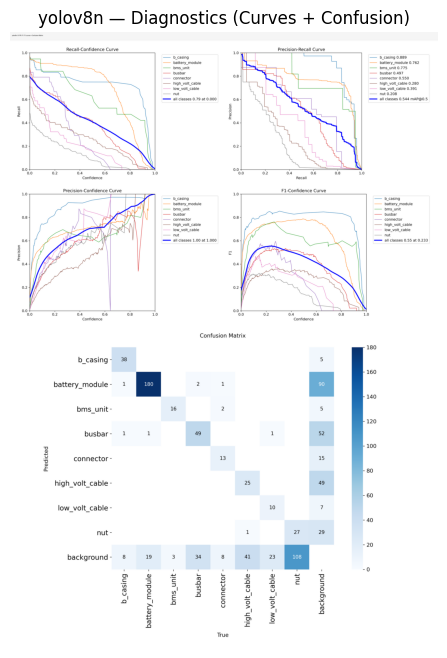

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov8inner/diagnostics_per_model/yolov8n_curves_confusion.png

=== yolov8s ===


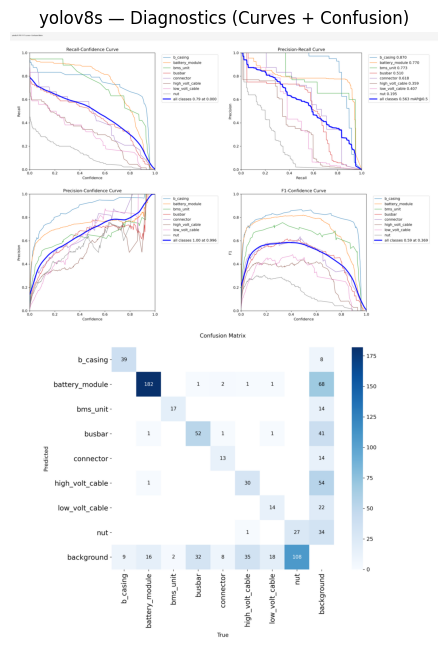

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov8inner/diagnostics_per_model/yolov8s_curves_confusion.png

=== yolov8m ===


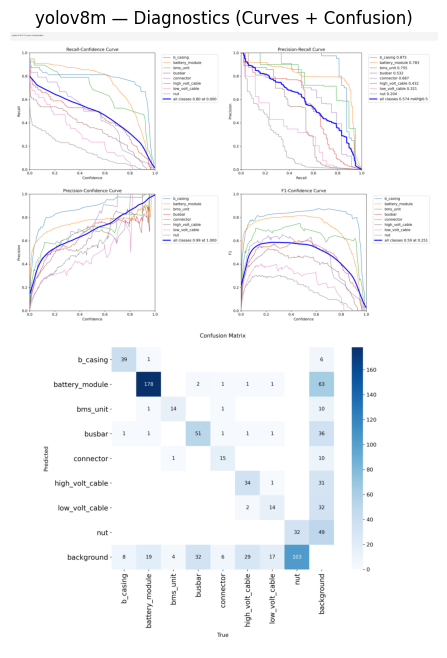

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov8inner/diagnostics_per_model/yolov8m_curves_confusion.png

=== yolov8l ===


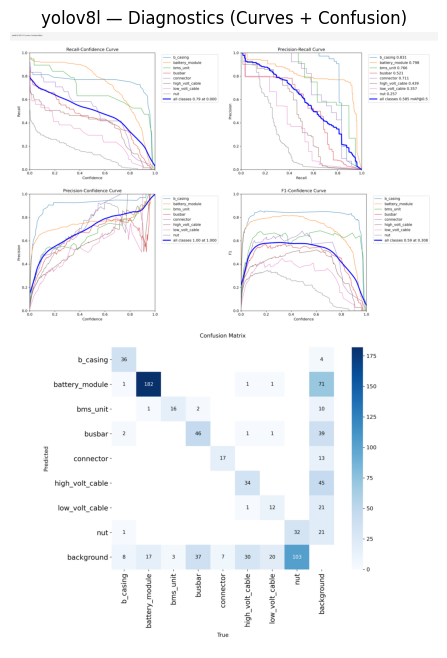

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov8inner/diagnostics_per_model/yolov8l_curves_confusion.png

=== yolov8x ===


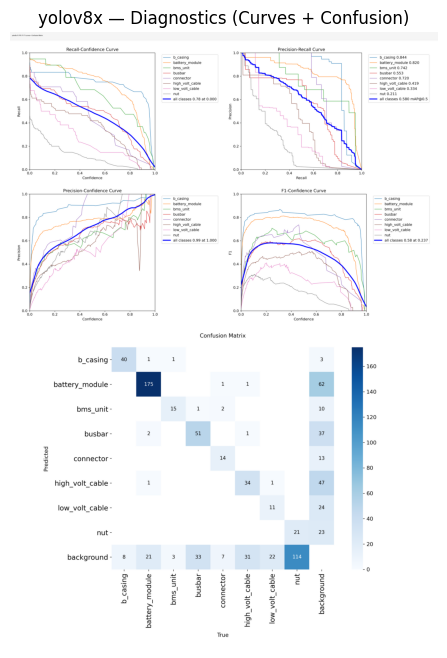

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov8inner/diagnostics_per_model/yolov8x_curves_confusion.png

DONE — YOLOv8inner diagnostics composites created.


In [2]:
from pathlib import Path
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt

# ----------------------------
# CONFIG
# ----------------------------
YOLOV8_DIR = Path("runs/report_val/yolov8inner")
MODELS = ["yolov8n", "yolov8s", "yolov8m", "yolov8l", "yolov8x"]

OUT_DIR = Path("report_figures/yolov8inner/diagnostics_per_model")
OUT_DIR.mkdir(parents=True, exist_ok=True)

CURVE_FILES = ["BoxR_curve.png", "BoxPR_curve.png", "BoxP_curve.png", "BoxF1_curve.png"]
CONF_FILE = "confusion_matrix.png"

BG = (255, 255, 255)
PAD = 14
TITLE_H = 60
MAX_W = 2200

# ----------------------------
# HELPERS
# ----------------------------
def load_img(p: Path):
    return Image.open(p).convert("RGB")

def resize_fit(img: Image.Image, max_w=MAX_W):
    w, h = img.size
    if w <= max_w:
        return img
    scale = max_w / w
    return img.resize((int(w * scale), int(h * scale)), Image.Resampling.LANCZOS)

def add_title(img: Image.Image, title: str):
    w, h = img.size
    canvas = Image.new("RGB", (w, h + TITLE_H), BG)
    canvas.paste(img, (0, TITLE_H))
    draw = ImageDraw.Draw(canvas)
    draw.rectangle([0, 0, w, TITLE_H], fill=(245, 245, 245))
    draw.text((PAD, 18), title, fill=(0, 0, 0))
    return canvas

def tile_2x2(imgs):
    """imgs length must be 4"""
    w = min(im.size[0] for im in imgs)
    resized = [im.resize((w, int(im.size[1]*w/im.size[0])), Image.Resampling.LANCZOS) for im in imgs]

    row1, row2 = resized[:2], resized[2:]
    h1 = max(im.size[1] for im in row1)
    h2 = max(im.size[1] for im in row2)

    out_w = 2*w + 3*PAD
    out_h = h1 + h2 + 3*PAD
    canvas = Image.new("RGB", (out_w, out_h), BG)

    canvas.paste(row1[0], (PAD, PAD))
    canvas.paste(row1[1], (PAD + w + PAD, PAD))

    y2 = PAD + h1 + PAD
    canvas.paste(row2[0], (PAD, y2))
    canvas.paste(row2[1], (PAD + w + PAD, y2))
    return canvas

def vstack(top, bottom):
    w = min(top.size[0], bottom.size[0])

    def fit_w(im):
        if im.size[0] == w:
            return im
        scale = w / im.size[0]
        return im.resize((w, int(im.size[1]*scale)), Image.Resampling.LANCZOS)

    top2 = fit_w(top)
    bottom2 = fit_w(bottom)

    out_w = w + 2*PAD
    out_h = top2.size[1] + bottom2.size[1] + 3*PAD
    canvas = Image.new("RGB", (out_w, out_h), BG)
    canvas.paste(top2, (PAD, PAD))
    canvas.paste(bottom2, (PAD, PAD + top2.size[1] + PAD))
    return canvas

def show(img, title):
    img = resize_fit(img)
    plt.figure(figsize=(14, 8))
    plt.imshow(img)
    plt.title(title)
    plt.axis("off")
    plt.show()

# ----------------------------
# BUILD + DISPLAY + SAVE
# ----------------------------
for m in MODELS:
    run_dir = YOLOV8_DIR / m
    print(f"\n=== {m} ===")

    missing = []
    curve_paths = []
    for f in CURVE_FILES:
        p = run_dir / f
        if not p.exists():
            missing.append(f)
        else:
            curve_paths.append(p)

    conf_path = run_dir / CONF_FILE
    if not conf_path.exists():
        missing.append(CONF_FILE)

    if missing:
        print(f"[SKIP] Missing files in {run_dir}: {missing}")
        continue

    curve_imgs = [load_img(p) for p in curve_paths]
    conf_img = load_img(conf_path)

    curves_grid = tile_2x2(curve_imgs)
    composite = vstack(curves_grid, conf_img)
    composite = add_title(composite, f"{m}: R / PR / P / F1 curves + Confusion Matrix")

    show(composite, f"{m} — Diagnostics (Curves + Confusion)")

    out_path = OUT_DIR / f"{m}_curves_confusion.png"
    composite = resize_fit(composite)
    composite.save(out_path, quality=95)
    print(f"Saved: {out_path.resolve()}")

print("\nDONE — YOLOv8inner diagnostics composites created.")



=== yolov8n ===


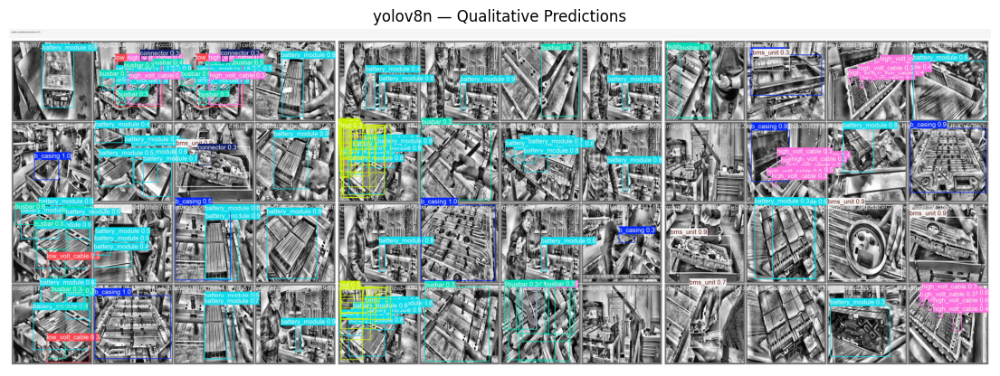

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov8inner/qualitative_per_model/yolov8n_qualitative_grid.png

=== yolov8s ===


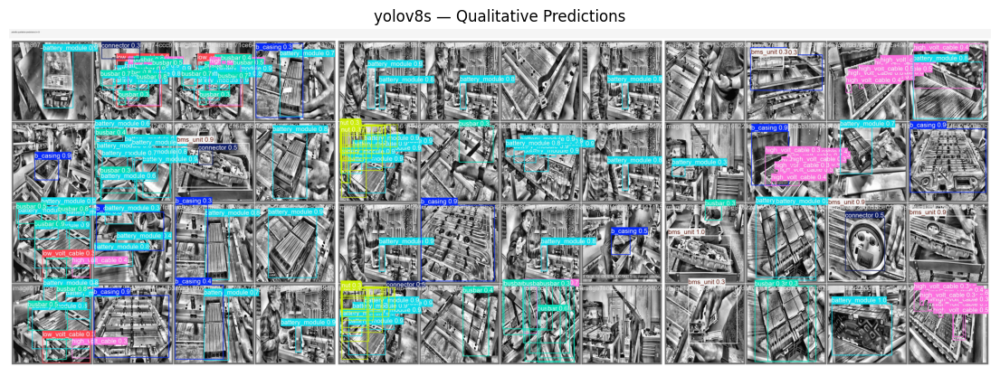

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov8inner/qualitative_per_model/yolov8s_qualitative_grid.png

=== yolov8m ===


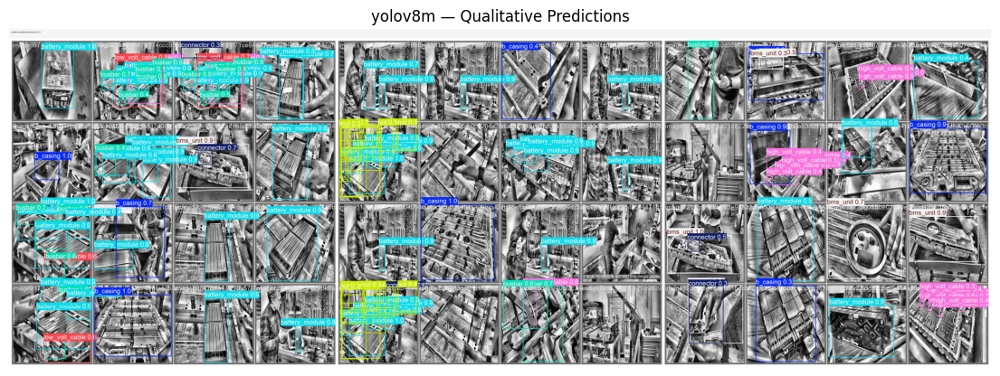

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov8inner/qualitative_per_model/yolov8m_qualitative_grid.png

=== yolov8l ===


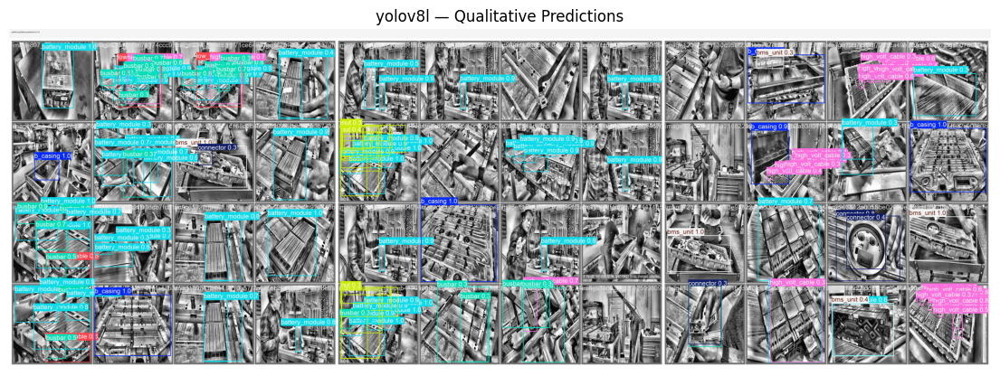

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov8inner/qualitative_per_model/yolov8l_qualitative_grid.png

=== yolov8x ===


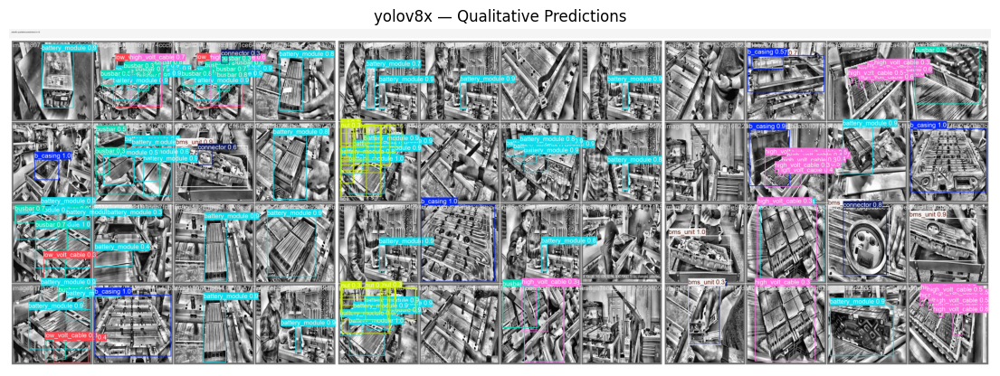

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/yolov8inner/qualitative_per_model/yolov8x_qualitative_grid.png

DONE — YOLOv8inner qualitative grids created.


In [3]:
from pathlib import Path
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import math

YOLOV8_DIR = Path("runs/report_val/yolov8inner")
MODELS = ["yolov8n", "yolov8s", "yolov8m", "yolov8l", "yolov8x"]

OUT_DIR = Path("report_figures/yolov8inner/qualitative_per_model")
OUT_DIR.mkdir(parents=True, exist_ok=True)

PRED_PATTERNS = ["val_batch*_pred.jpg", "val_batch*_pred.png"]
N_IMAGES = 6
COLS = 3

BG = (255, 255, 255)
PAD = 14
TITLE_H = 60
MAX_W = 2200

def load_img(p: Path):
    return Image.open(p).convert("RGB")

def resize_fit(img: Image.Image, max_w=MAX_W):
    w, h = img.size
    if w <= max_w:
        return img
    scale = max_w / w
    return img.resize((int(w * scale), int(h * scale)), Image.Resampling.LANCZOS)

def add_title(img: Image.Image, title: str):
    w, h = img.size
    canvas = Image.new("RGB", (w, h + TITLE_H), BG)
    canvas.paste(img, (0, TITLE_H))
    draw = ImageDraw.Draw(canvas)
    draw.rectangle([0, 0, w, TITLE_H], fill=(245, 245, 245))
    draw.text((PAD, 18), title, fill=(0, 0, 0))
    return canvas

def tile(images, cols=COLS):
    rows = math.ceil(len(images)/cols)
    w = min(i.size[0] for i in images)
    resized = [i.resize((w, int(i.size[1]*w/i.size[0])), Image.Resampling.LANCZOS) for i in images]

    row_heights = []
    for r in range(rows):
        row = resized[r*cols:(r+1)*cols]
        row_heights.append(max(im.size[1] for im in row))

    out_w = cols*w + (cols+1)*PAD
    out_h = sum(row_heights) + (rows+1)*PAD
    canvas = Image.new("RGB", (out_w, out_h), BG)

    y = PAD
    idx = 0
    for r in range(rows):
        x = PAD
        for c in range(cols):
            if idx >= len(resized):
                break
            canvas.paste(resized[idx], (x, y))
            x += w + PAD
            idx += 1
        y += row_heights[r] + PAD
    return canvas

def show(img, title):
    img = resize_fit(img)
    plt.figure(figsize=(14, 8))
    plt.imshow(img)
    plt.title(title)
    plt.axis("off")
    plt.show()

for m in MODELS:
    run_dir = YOLOV8_DIR / m
    print(f"\n=== {m} ===")

    pred_paths = []
    for pat in PRED_PATTERNS:
        pred_paths.extend(sorted(run_dir.glob(pat)))
    pred_paths = pred_paths[:N_IMAGES]

    if not pred_paths:
        print(f"[SKIP] No prediction images found in {run_dir}.")
        continue

    imgs = [load_img(p) for p in pred_paths]
    grid = tile(imgs, cols=COLS)
    grid = add_title(grid, f"{m}: qualitative predictions (n={len(pred_paths)})")

    show(grid, f"{m} — Qualitative Predictions")

    out_path = OUT_DIR / f"{m}_qualitative_grid.png"
    grid = resize_fit(grid)
    grid.save(out_path, quality=95)
    print(f"Saved: {out_path.resolve()}")

print("\nDONE — YOLOv8inner qualitative grids created.")


In [1]:
import os
import pandas as pd
import math
import matplotlib.pyplot as plt
from pathlib import Path
from PIL import Image
from ultralytics import YOLO

# ----------------------------
# CONFIG
# ----------------------------
custom_results = []

model_names = [
    "09_full_model",
    "03_baseline_plus_hgblocks",
    "custom_yolov9_outperform",
    "09_additive_full_model_Fusion_FIXED",
]

data_yaml_path = "Ev-Battery-Components-3/data.yaml"

WEIGHTS_FMT = "runs/custom/{name}/weights/best.pt"

OUT_ROOT = Path("runs/report_val/custom")
OUT_ROOT.mkdir(parents=True, exist_ok=True)

COLS = 3
FIG_W = 14
MAX_SHOW_PER_MODEL = 6

# ----------------------------
# HELPERS
# ----------------------------
def open_img(p, max_size=(1600, 1600)):
    img = Image.open(p).convert("RGB")
    img.thumbnail(max_size)
    return img

def show_grid(paths, title="", cols=COLS):
    paths = list(paths)
    if not paths:
        print(f"[No images found] {title}")
        return
    rows = math.ceil(len(paths) / cols)
    plt.figure(figsize=(FIG_W, rows * 4.5))
    for i, p in enumerate(paths, 1):
        ax = plt.subplot(rows, cols, i)
        ax.imshow(open_img(p))
        ax.set_title(Path(p).name, fontsize=9)
        ax.axis("off")
    plt.suptitle(title, fontsize=14, y=1.02)
    plt.tight_layout()
    plt.show()

def find_val_pred_images(run_dir: Path):
    imgs = []
    for pat in ["val_batch*_pred.jpg", "val_batch*_pred.png"]:
        imgs.extend(sorted(run_dir.glob(pat)))
    return imgs

# ----------------------------
# RUN + SAVE + PREVIEW
# ----------------------------
val_runs = {}

for name in model_names:
    weights_path = WEIGHTS_FMT.format(name=name)
    print(f"\nEvaluating {name}...")

    if not os.path.exists(weights_path):
        custom_results.append({"Model": name, "Error": "best.pt missing"})
        print(f"  [SKIP] Missing weights")
        continue

    model = YOLO(weights_path)

    metrics = model.val(
        data=data_yaml_path,
        imgsz=640,
        iou=0.7,
        conf=0.001,
        project=str(OUT_ROOT),
        name=name,
        exist_ok=True,
        save=True,     # saves val_batch*_pred.*
        plots=True     # saves curves + confusion matrix
    )

    out_dir = OUT_ROOT / name
    val_runs[name] = out_dir

    custom_results.append({
        "Model": name,
        "mAP50-95": metrics.box.map,
        "mAP50": metrics.box.map50,
        "Precision": metrics.box.mp,
        "Recall": metrics.box.mr,
    })

    pred_imgs = find_val_pred_images(out_dir)
    print(f"  Found {len(pred_imgs)} prediction images")
    show_grid(pred_imgs[:MAX_SHOW_PER_MODEL], title=f"{name} — preview")

display(pd.DataFrame(custom_results))



Evaluating 09_full_model...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
09_full_model summary: 629 layers, 29,515,598 parameters, 0 gradients, 19.0 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2298.7±393.8 MB/s, size: 53.1 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 145.2Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 3.5it/s 2.9s.2s
                   all        158        612      0.673      0.602      0.605      0.425
              b_casing         48   

<Figure size 1400x450 with 3 Axes>


Evaluating 03_baseline_plus_hgblocks...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
03_baseline_plus_hgblocks summary: 572 layers, 22,995,664 parameters, 0 gradients, 19.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2390.4±536.8 MB/s, size: 55.9 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 179.2Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 3.6it/s 2.8s.2ss
                   all        158        612      0.634      0.631      0.613       0.44
           

<Figure size 1400x450 with 3 Axes>


Evaluating custom_yolov9_outperform...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
custom_YOLOv9_outperform summary: 602 layers, 23,106,746 parameters, 0 gradients, 19.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2370.8±324.9 MB/s, size: 60.5 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 193.1Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 3.5it/s 2.8s.2ss
                   all        158        612      0.692      0.575      0.608      0.435
             

<Figure size 1400x450 with 3 Axes>


Evaluating 09_additive_full_model_Fusion_FIXED...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
09_additive_full_model_Fusion_FIXED summary: 587 layers, 24,190,712 parameters, 0 gradients, 19.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2480.0±509.2 MB/s, size: 63.7 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 184.7Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 3.6it/s 2.8s.2ss
                   all        158        612       0.65      0.637      0.607   

<Figure size 1400x450 with 3 Axes>

,Model,mAP50-95,mAP50,Precision,Recall
0,09_full_model,0.425297,0.604821,0.673075,0.601789
1,03_baseline_plus_hgblocks,0.440407,0.613062,0.633821,0.631025
2,custom_yolov9_outperform,0.434941,0.608203,0.692086,0.575071
3,09_additive_full_model_Fusion_FIXED,0.436725,0.607162,0.650325,0.636621



=== 09_full_model ===


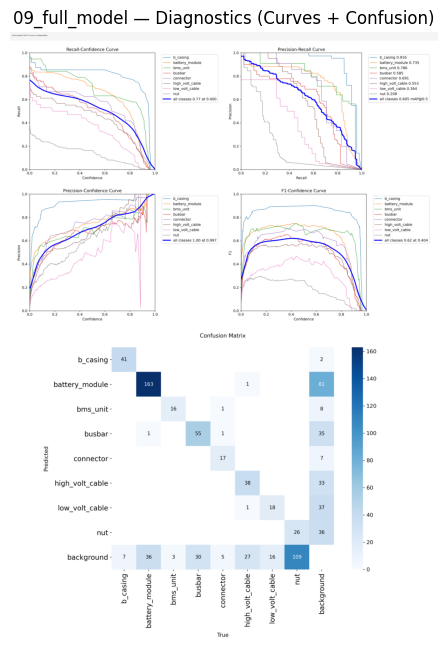

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/custom/diagnostics_per_model/09_full_model_curves_confusion.png

=== 03_baseline_plus_hgblocks ===


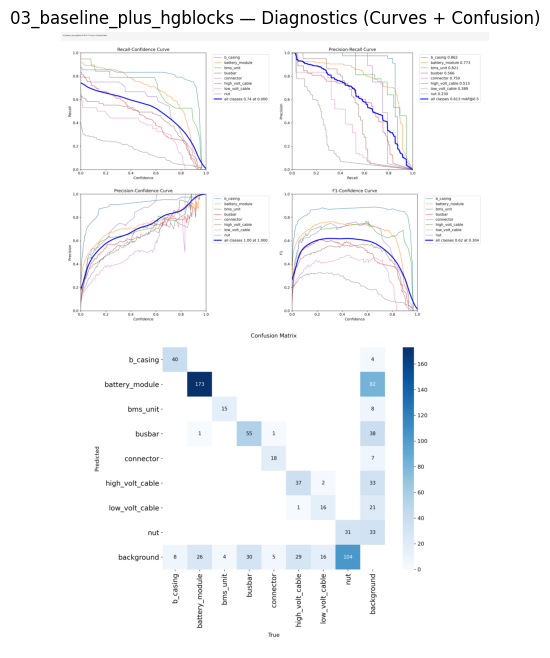

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/custom/diagnostics_per_model/03_baseline_plus_hgblocks_curves_confusion.png

=== custom_yolov9_outperform ===


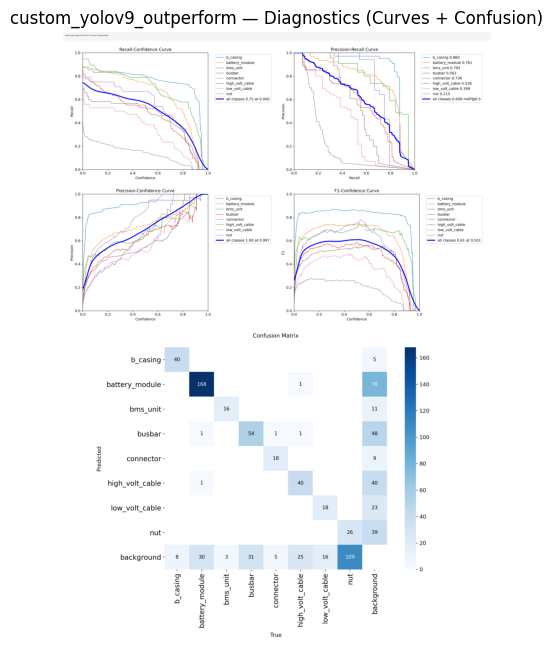

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/custom/diagnostics_per_model/custom_yolov9_outperform_curves_confusion.png

=== 09_additive_full_model_Fusion_FIXED ===


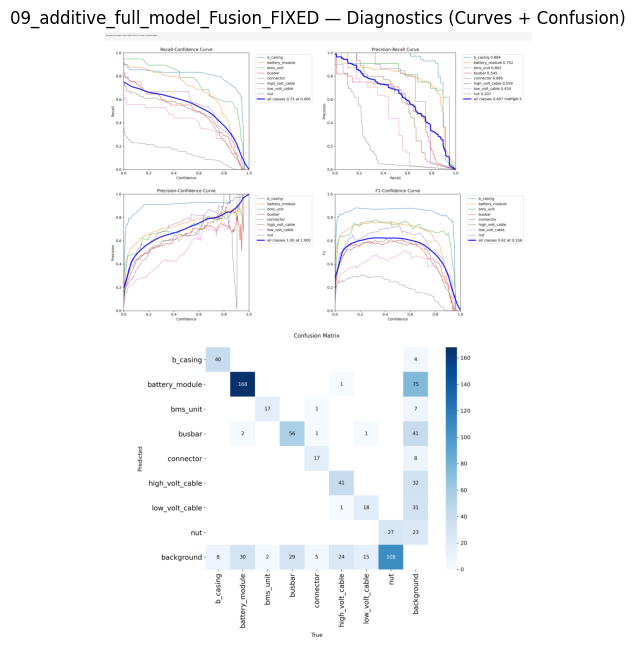

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/custom/diagnostics_per_model/09_additive_full_model_Fusion_FIXED_curves_confusion.png

DONE — custom model diagnostics composites created.


In [4]:
from pathlib import Path
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt

# ----------------------------
# CONFIG (CUSTOM MODELS)
# ----------------------------
CUSTOM_DIR = Path("runs/report_val/custom")

MODELS = [
    "09_full_model",
    "03_baseline_plus_hgblocks",
    "custom_yolov9_outperform",
    "09_additive_full_model_Fusion_FIXED",
]

OUT_DIR = Path("report_figures/custom/diagnostics_per_model")
OUT_DIR.mkdir(parents=True, exist_ok=True)

# Use your exact filenames (same style you used for yolov8inner)
CURVE_FILES = ["BoxR_curve.png", "BoxPR_curve.png", "BoxP_curve.png", "BoxF1_curve.png"]
CONF_FILE = "confusion_matrix.png"

BG = (255, 255, 255)
PAD = 14
TITLE_H = 60
MAX_W = 2200

# ----------------------------
# HELPERS
# ----------------------------
def load_img(p: Path):
    return Image.open(p).convert("RGB")

def resize_fit(img: Image.Image, max_w=MAX_W):
    w, h = img.size
    if w <= max_w:
        return img
    scale = max_w / w
    return img.resize((int(w * scale), int(h * scale)), Image.Resampling.LANCZOS)

def add_title(img: Image.Image, title: str):
    w, h = img.size
    canvas = Image.new("RGB", (w, h + TITLE_H), BG)
    canvas.paste(img, (0, TITLE_H))
    draw = ImageDraw.Draw(canvas)
    draw.rectangle([0, 0, w, TITLE_H], fill=(245, 245, 245))
    draw.text((PAD, 18), title, fill=(0, 0, 0))
    return canvas

def tile_2x2(imgs):
    """imgs length must be 4"""
    w = min(im.size[0] for im in imgs)
    resized = [im.resize((w, int(im.size[1]*w/im.size[0])), Image.Resampling.LANCZOS) for im in imgs]

    row1, row2 = resized[:2], resized[2:]
    h1 = max(im.size[1] for im in row1)
    h2 = max(im.size[1] for im in row2)

    out_w = 2*w + 3*PAD
    out_h = h1 + h2 + 3*PAD
    canvas = Image.new("RGB", (out_w, out_h), BG)

    canvas.paste(row1[0], (PAD, PAD))
    canvas.paste(row1[1], (PAD + w + PAD, PAD))

    y2 = PAD + h1 + PAD
    canvas.paste(row2[0], (PAD, y2))
    canvas.paste(row2[1], (PAD + w + PAD, y2))
    return canvas

def vstack(top, bottom):
    w = min(top.size[0], bottom.size[0])

    def fit_w(im):
        if im.size[0] == w:
            return im
        scale = w / im.size[0]
        return im.resize((w, int(im.size[1]*scale)), Image.Resampling.LANCZOS)

    top2 = fit_w(top)
    bottom2 = fit_w(bottom)

    out_w = w + 2*PAD
    out_h = top2.size[1] + bottom2.size[1] + 3*PAD
    canvas = Image.new("RGB", (out_w, out_h), BG)
    canvas.paste(top2, (PAD, PAD))
    canvas.paste(bottom2, (PAD, PAD + top2.size[1] + PAD))
    return canvas

def show(img, title):
    img = resize_fit(img)
    plt.figure(figsize=(14, 8))
    plt.imshow(img)
    plt.title(title)
    plt.axis("off")
    plt.show()

# ----------------------------
# BUILD + DISPLAY + SAVE
# ----------------------------
for m in MODELS:
    run_dir = CUSTOM_DIR / m
    print(f"\n=== {m} ===")

    if not run_dir.exists():
        print(f"[SKIP] Folder not found: {run_dir}")
        continue

    missing = []
    curve_paths = []
    for f in CURVE_FILES:
        p = run_dir / f
        if not p.exists():
            missing.append(f)
        else:
            curve_paths.append(p)

    conf_path = run_dir / CONF_FILE
    if not conf_path.exists():
        missing.append(CONF_FILE)

    if missing:
        print(f"[SKIP] Missing files in {run_dir}: {missing}")
        continue

    curve_imgs = [load_img(p) for p in curve_paths]
    conf_img = load_img(conf_path)

    curves_grid = tile_2x2(curve_imgs)
    composite = vstack(curves_grid, conf_img)
    composite = add_title(composite, f"{m}: R / PR / P / F1 curves + Confusion Matrix")

    show(composite, f"{m} — Diagnostics (Curves + Confusion)")

    out_path = OUT_DIR / f"{m}_curves_confusion.png"
    composite = resize_fit(composite)
    composite.save(out_path, quality=95)
    print(f"Saved: {out_path.resolve()}")

print("\nDONE — custom model diagnostics composites created.")



=== 09_full_model ===


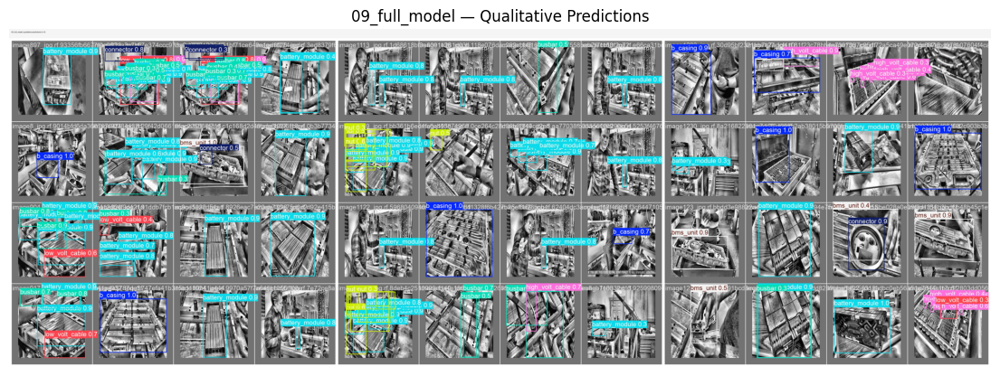

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/custom/qualitative_per_model/09_full_model_qualitative_grid.png

=== 03_baseline_plus_hgblocks ===


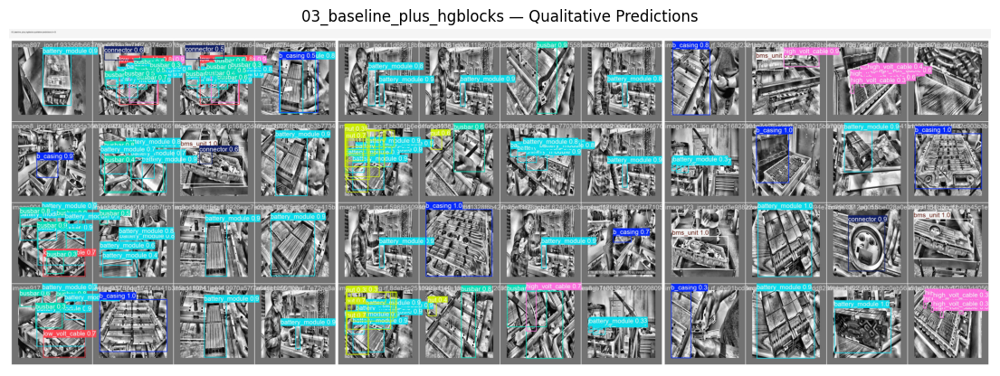

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/custom/qualitative_per_model/03_baseline_plus_hgblocks_qualitative_grid.png

=== custom_yolov9_outperform ===


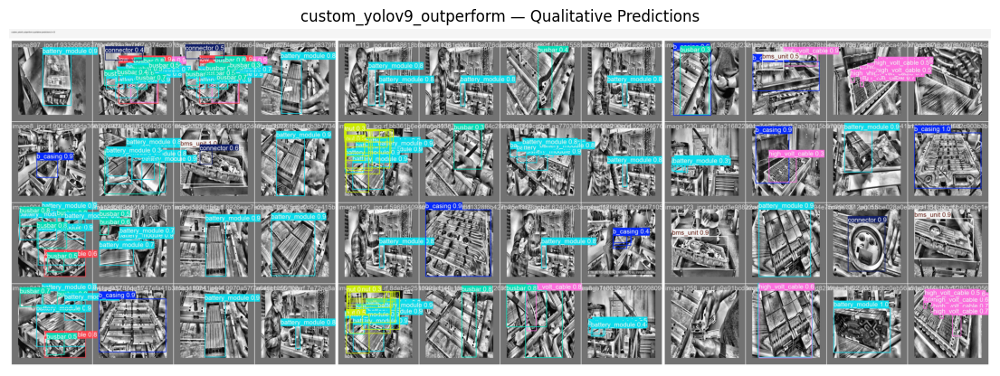

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/custom/qualitative_per_model/custom_yolov9_outperform_qualitative_grid.png

=== 09_additive_full_model_Fusion_FIXED ===


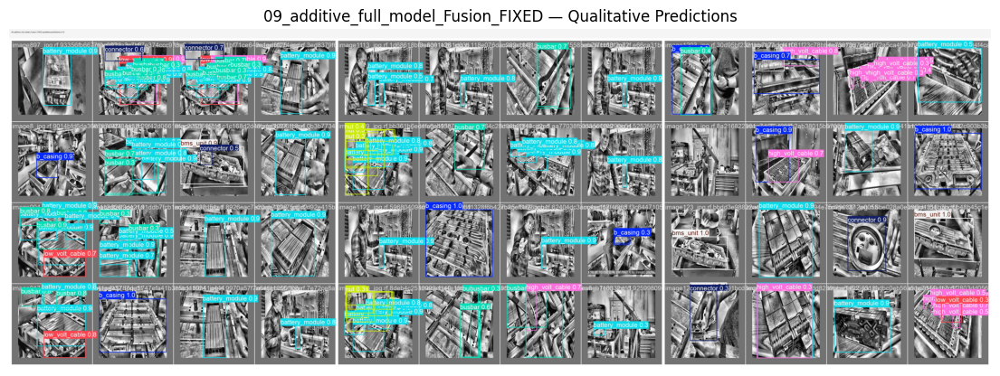

Saved: /home/250027044/ultralyticsWithEfficientNetB3/report_figures/custom/qualitative_per_model/09_additive_full_model_Fusion_FIXED_qualitative_grid.png

DONE — custom model qualitative grids created.


In [5]:
from pathlib import Path
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import math

# ----------------------------
# CONFIG (CUSTOM MODELS)
# ----------------------------
CUSTOM_DIR = Path("runs/report_val/custom")

MODELS = [
    "09_full_model",
    "03_baseline_plus_hgblocks",
    "custom_yolov9_outperform",
    "09_additive_full_model_Fusion_FIXED",
]

OUT_DIR = Path("report_figures/custom/qualitative_per_model")
OUT_DIR.mkdir(parents=True, exist_ok=True)

PRED_PATTERNS = ["val_batch*_pred.jpg", "val_batch*_pred.png"]
N_IMAGES = 6
COLS = 3

BG = (255, 255, 255)
PAD = 14
TITLE_H = 60
MAX_W = 2200

# ----------------------------
# HELPERS
# ----------------------------
def load_img(p: Path):
    return Image.open(p).convert("RGB")

def resize_fit(img: Image.Image, max_w=MAX_W):
    w, h = img.size
    if w <= max_w:
        return img
    scale = max_w / w
    return img.resize((int(w * scale), int(h * scale)), Image.Resampling.LANCZOS)

def add_title(img: Image.Image, title: str):
    w, h = img.size
    canvas = Image.new("RGB", (w, h + TITLE_H), BG)
    canvas.paste(img, (0, TITLE_H))
    draw = ImageDraw.Draw(canvas)
    draw.rectangle([0, 0, w, TITLE_H], fill=(245, 245, 245))
    draw.text((PAD, 18), title, fill=(0, 0, 0))
    return canvas

def tile(images, cols=COLS):
    rows = math.ceil(len(images) / cols)
    w = min(i.size[0] for i in images)
    resized = [i.resize((w, int(i.size[1] * w / i.size[0])), Image.Resampling.LANCZOS) for i in images]

    row_heights = []
    for r in range(rows):
        row = resized[r * cols:(r + 1) * cols]
        row_heights.append(max(im.size[1] for im in row))

    out_w = cols * w + (cols + 1) * PAD
    out_h = sum(row_heights) + (rows + 1) * PAD
    canvas = Image.new("RGB", (out_w, out_h), BG)

    y = PAD
    idx = 0
    for r in range(rows):
        x = PAD
        for c in range(cols):
            if idx >= len(resized):
                break
            canvas.paste(resized[idx], (x, y))
            x += w + PAD
            idx += 1
        y += row_heights[r] + PAD
    return canvas

def show(img, title):
    img = resize_fit(img)
    plt.figure(figsize=(14, 8))
    plt.imshow(img)
    plt.title(title)
    plt.axis("off")
    plt.show()

# ----------------------------
# BUILD + DISPLAY + SAVE
# ----------------------------
for m in MODELS:
    run_dir = CUSTOM_DIR / m
    print(f"\n=== {m} ===")

    if not run_dir.exists():
        print(f"[SKIP] Folder not found: {run_dir}")
        continue

    pred_paths = []
    for pat in PRED_PATTERNS:
        pred_paths.extend(sorted(run_dir.glob(pat)))
    pred_paths = pred_paths[:N_IMAGES]

    if not pred_paths:
        print(f"[SKIP] No prediction images found in {run_dir}.")
        continue

    imgs = [load_img(p) for p in pred_paths]
    grid = tile(imgs, cols=COLS)
    grid = add_title(grid, f"{m}: qualitative predictions (n={len(pred_paths)})")

    show(grid, f"{m} — Qualitative Predictions")

    out_path = OUT_DIR / f"{m}_qualitative_grid.png"
    grid = resize_fit(grid)
    grid.save(out_path, quality=95)
    print(f"Saved: {out_path.resolve()}")

print("\nDONE — custom model qualitative grids created.")


In [ ]:
from ultralytics import YOLO
import os
import yaml
import pandas as pd
from datetime import datetime

# List of all ablation config variants
configs = [
    "ultralytics/cfg/models/ablation/00_baseline.yaml",
    "ultralytics/cfg/models/ablation/01_baseline_plus_efficientnet.yaml",
    "ultralytics/cfg/models/ablation/02_baseline_plus_fablocks.yaml",
    "ultralytics/cfg/models/ablation/03_baseline_plus_hgblocks.yaml",
]



results = []
DATASET = "Ev-Battery-Components-3/data.yaml"
EPOCHS = 100
BATCH = 16
IMGSZ = 640
DEVICE = "2,3"  # booked GPUs

# Run all ablation models
for cfg in configs:
    model_name = os.path.splitext(os.path.basename(cfg))[0]
    print(f"\n🚀 Training ablation variant: {model_name}\n{'='*60}")

    model = YOLO(cfg)
    r = model.train(
        data=DATASET,
        epochs=EPOCHS,
        batch=BATCH,
        imgsz=IMGSZ,
        device=DEVICE,
        project="runs/ablation_EV_25",
        name=model_name,
        exist_ok=True
    )

    # Locate results file (YAML, CSV, or JSON)
    base_path = f"runs/ablation_EV_25/{model_name}"
    possible_files = [
        os.path.join(base_path, "results.yaml"),
        os.path.join(base_path, "results.csv"),
        os.path.join(base_path, "results.json")
    ]
    metrics = {}
    found = False

    for file in possible_files:
        if os.path.exists(file):
            found = True
            if file.endswith(".yaml"):
                with open(file) as f:
                    metrics = yaml.safe_load(f)
            elif file.endswith(".csv"):
                df_metrics = pd.read_csv(file)
                metrics = df_metrics.iloc[-1].to_dict()
            elif file.endswith(".json"):
                import json
                with open(file) as f:
                    metrics = json.load(f)
            break

    if found:
        results.append({
            "model": model_name,
            "mAP50": metrics.get("metrics/mAP50(B)", metrics.get("metrics/mAP50", None)),
            "mAP50-95": metrics.get("metrics/mAP50-95(B)", metrics.get("metrics/mAP50-95", None)),
            "precision": metrics.get("metrics/precision(B)", metrics.get("metrics/precision", None)),
            "recall": metrics.get("metrics/recall(B)", metrics.get("metrics/recall", None)),
            "params": metrics.get("model/parameters", None),
            "flops": metrics.get("model/FLOPs", None),
            "timestamp": datetime.now().strftime("%Y-%m-%d %H:%M:%S")
        })
        print(f"✅ Metrics collected for {model_name}")
    else:
        print(f"⚠️ No results found for {model_name}")

# Save summary
df = pd.DataFrame(results)
df.to_csv("runs/ablation_EV_25/ablation_results.csv", index=False)
print("\n✅ ablation study complete! Results saved to runs/ablation/ablation_results.csv")
display(df)



🚀 Training ablation variant: 00_baseline
New https://pypi.org/project/ultralytics/8.4.0 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:2 (NVIDIA RTX A6000, 48539MiB)
                                                        CUDA:3 (NVIDIA RTX A6000, 48539MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=Ev-Battery-Components-3/data.yaml, degrees=0.0, deterministic=True, device=2,3, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, 

[E ProcessGroupNCCL.cpp:828] [Rank 1] Watchdog caught collective operation timeout: WorkNCCL(SeqNum=2653, OpType=BROADCAST, Timeout(ms)=10800000) ran for 10802543 milliseconds before timing out.
Traceback (most recent call last):
  File "/users/2/250027044/.config/Ultralytics/DDP/_temp_e_bgisrm127463413187008.py", line 13, in <module>
  File "/home/250027044/ultralyticsWithEfficientNetB3/ultralytics/engine/trainer.py", line 230, in train
    self._do_train(world_size)
  File "/home/250027044/ultralyticsWithEfficientNetB3/ultralytics/engine/trainer.py", line 488, in _do_train
    dist.broadcast_object_list(broadcast_list, 0)  # broadcast 'stop' to all ranks
  File "/users/2/250027044/anaconda3/envs/yolov9_custom_ultralytics/lib/python3.10/site-packages/torch/distributed/distributed_c10d.py", line 1436, in wrapper
    return func(*args, **kwargs)
  File "/users/2/250027044/anaconda3/envs/yolov9_custom_ultralytics/lib/python3.10/site-packages/torch/distributed/distributed_c10d.py", line 2

     68/100        20G      2.552      3.099      2.436         77        640: 73% ━━━━━━━━╸─── 97/132 2.8it/s 44.9s<12.3s

In [1]:
from ultralytics import YOLO
import os
import yaml
import pandas as pd
from datetime import datetime

# List of all ablation config variants
configs = [
    "ultralytics/cfg/models/ablation/02_baseline_plus_fablocks.yaml",
    "ultralytics/cfg/models/ablation/03_baseline_plus_hgblocks.yaml",
]



results = []
DATASET = "Ev-Battery-Components-3/data.yaml"
EPOCHS = 100
BATCH = 16
IMGSZ = 640
DEVICE = "2,3"  # booked GPUs

# Run all ablation models
for cfg in configs:
    model_name = os.path.splitext(os.path.basename(cfg))[0]
    print(f"\n🚀 Training ablation variant: {model_name}\n{'='*60}")

    model = YOLO(cfg)
    r = model.train(
        data=DATASET,
        epochs=EPOCHS,
        batch=BATCH,
        imgsz=IMGSZ,
        device=DEVICE,
        project="runs/ablation_EV_25",
        name=model_name,
        exist_ok=True
    )

    # Locate results file (YAML, CSV, or JSON)
    base_path = f"runs/ablation_EV_25/{model_name}"
    possible_files = [
        os.path.join(base_path, "results.yaml"),
        os.path.join(base_path, "results.csv"),
        os.path.join(base_path, "results.json")
    ]
    metrics = {}
    found = False

    for file in possible_files:
        if os.path.exists(file):
            found = True
            if file.endswith(".yaml"):
                with open(file) as f:
                    metrics = yaml.safe_load(f)
            elif file.endswith(".csv"):
                df_metrics = pd.read_csv(file)
                metrics = df_metrics.iloc[-1].to_dict()
            elif file.endswith(".json"):
                import json
                with open(file) as f:
                    metrics = json.load(f)
            break

    if found:
        results.append({
            "model": model_name,
            "mAP50": metrics.get("metrics/mAP50(B)", metrics.get("metrics/mAP50", None)),
            "mAP50-95": metrics.get("metrics/mAP50-95(B)", metrics.get("metrics/mAP50-95", None)),
            "precision": metrics.get("metrics/precision(B)", metrics.get("metrics/precision", None)),
            "recall": metrics.get("metrics/recall(B)", metrics.get("metrics/recall", None)),
            "params": metrics.get("model/parameters", None),
            "flops": metrics.get("model/FLOPs", None),
            "timestamp": datetime.now().strftime("%Y-%m-%d %H:%M:%S")
        })
        print(f"✅ Metrics collected for {model_name}")
    else:
        print(f"⚠️ No results found for {model_name}")

# Save summary
df = pd.DataFrame(results)
df.to_csv("runs/ablation_EV_25/ablation_results.csv", index=False)
print("\n✅ ablation study complete! Results saved to runs/ablation/ablation_results.csv")
display(df)



🚀 Training ablation variant: 02_baseline_plus_fablocks
New https://pypi.org/project/ultralytics/8.4.2 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:2 (NVIDIA RTX A6000, 48539MiB)
                                                        CUDA:3 (NVIDIA RTX A6000, 48539MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=Ev-Battery-Components-3/data.yaml, degrees=0.0, deterministic=True, device=2,3, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4,

,model,mAP50,mAP50-95,precision,recall,params,flops,timestamp
0,02_baseline_plus_fablocks,0.21304,0.13011,0.33013,0.25041,None,None,2026-01-15 14:04:51
1,03_baseline_plus_hgblocks,0.19128,0.09987,0.31431,0.20679,None,None,2026-01-15 17:09:04


In [3]:
import pandas as pd
from ultralytics import YOLO
import os
ablation_EV_results = []

models = ["00_baseline", "01_baseline_plus_efficientnet", "02_baseline_plus_fablocks", "03_baseline_plus_hgblocks"]

data_yaml_path = "Ev-Battery-Components-3/data.yaml"

for name in models:
    weights_path = f"runs/ablation_EV_25/{name}/weights/best.pt"
    print(f"\nEvaluating {name}...")

    if os.path.exists(weights_path):
        model = YOLO(weights_path)
        metrics = model.val(data=data_yaml_path, imgsz=640, iou=0.7, conf=0.001)
        
        ablation_EV_results.append({
            "Model": name,
            "mAP50-95": metrics.box.map,
            "mAP50": metrics.box.map50,
            "Precision": metrics.box.mp,
            "Recall": metrics.box.mr,
        })
    else:
        ablation_EV_results.append({"Model": name, "Error": "best.pt missing"})

display(pd.DataFrame(ablation_EV_results))



Evaluating 00_baseline...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
00_baseline summary: 89 layers, 5,621,736 parameters, 0 gradients, 288.8 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2542.1±486.9 MB/s, size: 54.7 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 198.1Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 2.0it/s 5.0s.4ss
                   all        158        612      0.416      0.187      0.164     0.0963
              b_casing         48       

,Model,mAP50-95,mAP50,Precision,Recall
0,00_baseline,0.096324,0.163920,0.415592,0.187270
1,01_baseline_plus_efficientnet,0.434129,0.611635,0.647312,0.613834
2,02_baseline_plus_fablocks,0.130021,0.212892,0.328977,0.250329
3,03_baseline_plus_hgblocks,0.103464,0.190120,0.327202,0.207526


In [ ]:
from ultralytics import YOLO
import os
import yaml
import pandas as pd
from datetime import datetime
import torch
import gc

configs = [
    "ultralytics/cfg/models/additive/01_baseline_plus_efficientnet.yaml",
    "ultralytics/cfg/models/additive/02_baseline_plus_fablocks.yaml",
    "ultralytics/cfg/models/additive/03_baseline_plus_hgblocks.yaml",
    "ultralytics/cfg/models/additive/04_baseline_plus_spdadown.yaml",
    "ultralytics/cfg/models/additive/05_baseline_plus_dropblock.yaml",
    "ultralytics/cfg/models/additive/06_baseline_plus_cbam.yaml",
    "ultralytics/cfg/models/additive/07_baseline_plus_bifpn.yaml",
    "ultralytics/cfg/models/additive/08_baseline_plus_context.yaml",
    "ultralytics/cfg/models/additive/09_additive_full_model_Fusion_FIXED.yaml",
]



DATASET = "Ev-Battery-Components-3/data.yaml"
EPOCHS = 100
BATCH = 16
IMGSZ = 640
DEVICE = "2"  # booked GPUs

results = []

for cfg in configs:
    model_name = os.path.splitext(os.path.basename(cfg))[0]
    print(f"\n🚀 Training ablation variant: {model_name}\n{'='*60}")

    model = YOLO(cfg)

    r = model.train(
        data=DATASET,
        epochs=EPOCHS,
        batch=BATCH,
        imgsz=IMGSZ,
        device=DEVICE,
        project="runs/ablation_EV_25",
        name=model_name,
        exist_ok=True
    )

    base_path = f"runs/ablation_EV_25/{model_name}"
    results_file = os.path.join(base_path, "results.csv")

    if os.path.exists(results_file):
        df_metrics = pd.read_csv(results_file)
        last = df_metrics.iloc[-1]

        results.append({
            "model": model_name,
            "mAP50": last.get("metrics/mAP50(B)", None),
            "mAP50-95": last.get("metrics/mAP50-95(B)", None),
            "precision": last.get("metrics/precision(B)", None),
            "recall": last.get("metrics/recall(B)", None),
            "params": last.get("model/parameters", None),
            "flops": last.get("model/FLOPs", None),
            "timestamp": datetime.now().strftime("%Y-%m-%d %H:%M:%S")
        })
        print(f"✅ Metrics collected for {model_name}")
    else:
        print(f"⚠️ No results found for {model_name}")

    # 🔥 HARD CLEANUP (VERY IMPORTANT)
    del model
    torch.cuda.empty_cache()
    gc.collect()

# Save summary
df = pd.DataFrame(results)
os.makedirs("runs/ablation_EV_25", exist_ok=True)
df.to_csv("runs/ablation_EV_25/ablation_results.csv", index=False)

print("\n✅ Ablation study complete!")
display(df)



🚀 Training ablation variant: 01_baseline_plus_efficientnet
New https://pypi.org/project/ultralytics/8.4.3 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:2 (NVIDIA RTX A6000, 48539MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=Ev-Battery-Components-3/data.yaml, degrees=0.0, deterministic=True, device=2, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=ultralytics/cfg/models/additive/01_baseline_plu

In [ ]:
from ultralytics import YOLO
import os
import yaml
import pandas as pd
from datetime import datetime
import torch
import gc

configs = [
    
    "ultralytics/cfg/models/additive/07_baseline_plus_bifpn.yaml",
    "ultralytics/cfg/models/additive/08_baseline_plus_context.yaml",
    "ultralytics/cfg/models/additive/09_additive_full_model_Fusion_FIXED.yaml",
]



DATASET = "Ev-Battery-Components-3/data.yaml"
EPOCHS = 100
BATCH = 16
IMGSZ = 640
DEVICE = "2"  # booked GPUs

results = []

for cfg in configs:
    model_name = os.path.splitext(os.path.basename(cfg))[0]
    print(f"\n🚀 Training ablation variant: {model_name}\n{'='*60}")

    model = YOLO(cfg)

    r = model.train(
        data=DATASET,
        epochs=EPOCHS,
        batch=BATCH,
        imgsz=IMGSZ,
        device=DEVICE,
        project="runs/ablation_EV_25",
        name=model_name,
        exist_ok=True
    )

    base_path = f"runs/ablation_EV_25/{model_name}"
    results_file = os.path.join(base_path, "results.csv")

    if os.path.exists(results_file):
        df_metrics = pd.read_csv(results_file)
        last = df_metrics.iloc[-1]

        results.append({
            "model": model_name,
            "mAP50": last.get("metrics/mAP50(B)", None),
            "mAP50-95": last.get("metrics/mAP50-95(B)", None),
            "precision": last.get("metrics/precision(B)", None),
            "recall": last.get("metrics/recall(B)", None),
            "params": last.get("model/parameters", None),
            "flops": last.get("model/FLOPs", None),
            "timestamp": datetime.now().strftime("%Y-%m-%d %H:%M:%S")
        })
        print(f"✅ Metrics collected for {model_name}")
    else:
        print(f"⚠️ No results found for {model_name}")

    # 🔥 HARD CLEANUP (VERY IMPORTANT)
    del model
    torch.cuda.empty_cache()
    gc.collect()

# Save summary
df = pd.DataFrame(results)
os.makedirs("runs/ablation_EV_25", exist_ok=True)
df.to_csv("runs/ablation_EV_25/ablation_results.csv", index=False)

print("\n✅ Ablation study complete!")
display(df)



🚀 Training ablation variant: 07_baseline_plus_bifpn
New https://pypi.org/project/ultralytics/8.4.3 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:2 (NVIDIA RTX A6000, 48539MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=Ev-Battery-Components-3/data.yaml, degrees=0.0, deterministic=True, device=2, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=ultralytics/cfg/models/additive/07_baseline_plus_bifpn

In [2]:
from ultralytics import YOLO
import os
import yaml
import pandas as pd
from datetime import datetime
import torch
import gc

configs = [
    
    "ultralytics/cfg/models/additive/09_additive_full_model_Fusion_FIXED.yaml",
]



DATASET = "Ev-Battery-Components-3/data.yaml"
EPOCHS = 100
BATCH = 16
IMGSZ = 640
DEVICE = "2"  # booked GPUs

results = []

for cfg in configs:
    model_name = os.path.splitext(os.path.basename(cfg))[0]
    print(f"\n🚀 Training ablation variant: {model_name}\n{'='*60}")

    model = YOLO(cfg)

    r = model.train(
        data=DATASET,
        epochs=EPOCHS,
        batch=BATCH,
        imgsz=IMGSZ,
        device=DEVICE,
        project="runs/ablation_EV_25",
        name=model_name,
        exist_ok=True
    )

    base_path = f"runs/ablation_EV_25/{model_name}"
    results_file = os.path.join(base_path, "results.csv")

    if os.path.exists(results_file):
        df_metrics = pd.read_csv(results_file)
        last = df_metrics.iloc[-1]

        results.append({
            "model": model_name,
            "mAP50": last.get("metrics/mAP50(B)", None),
            "mAP50-95": last.get("metrics/mAP50-95(B)", None),
            "precision": last.get("metrics/precision(B)", None),
            "recall": last.get("metrics/recall(B)", None),
            "params": last.get("model/parameters", None),
            "flops": last.get("model/FLOPs", None),
            "timestamp": datetime.now().strftime("%Y-%m-%d %H:%M:%S")
        })
        print(f"✅ Metrics collected for {model_name}")
    else:
        print(f"⚠️ No results found for {model_name}")

    # 🔥 HARD CLEANUP (VERY IMPORTANT)
    del model
    torch.cuda.empty_cache()
    gc.collect()

# Save summary
df = pd.DataFrame(results)
os.makedirs("runs/ablation_EV_25", exist_ok=True)
df.to_csv("runs/ablation_EV_25/ablation_results.csv", index=False)

print("\n✅ Ablation study complete!")
display(df)



🚀 Training ablation variant: 09_additive_full_model_Fusion_FIXED
New https://pypi.org/project/ultralytics/8.4.4 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:2 (NVIDIA RTX A6000, 48539MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=Ev-Battery-Components-3/data.yaml, degrees=0.0, deterministic=True, device=2, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=ultralytics/cfg/models/additive/09_additi

,model,mAP50,mAP50-95,precision,recall,params,flops,timestamp
0,09_additive_full_model_Fusion_FIXED,0.61411,0.43606,0.68617,0.6064,None,None,2026-01-16 18:30:52


In [3]:
import pandas as pd
from ultralytics import YOLO
import os
ablation_EV_results = []

models = ["00_baseline", "01_baseline_plus_efficientnet", "02_baseline_plus_fablocks", "03_baseline_plus_hgblocks"]

data_yaml_path = "Ev-Battery-Components-3/data.yaml"

for name in models:
    weights_path = f"runs/ablation_EV_25/{name}/weights/best.pt"
    print(f"\nEvaluating {name}...")

    if os.path.exists(weights_path):
        model = YOLO(weights_path)
        metrics = model.val(data=data_yaml_path, imgsz=640, iou=0.7, conf=0.001)
        
        ablation_EV_results.append({
            "Model": name,
            "mAP50-95": metrics.box.map,
            "mAP50": metrics.box.map50,
            "Precision": metrics.box.mp,
            "Recall": metrics.box.mr,
        })
    else:
        ablation_EV_results.append({"Model": name, "Error": "best.pt missing"})

display(pd.DataFrame(ablation_EV_results))



Evaluating 00_baseline...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
00_baseline summary: 89 layers, 5,621,736 parameters, 0 gradients, 288.8 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2196.2±191.7 MB/s, size: 53.7 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 197.8Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 2.2it/s 4.6s.4ss
                   all        158        612      0.416      0.187      0.164     0.0963
              b_casing         48       

,Model,mAP50-95,mAP50,Precision,Recall
0,00_baseline,0.096324,0.163920,0.415592,0.187270
1,01_baseline_plus_efficientnet,0.434562,0.610743,0.678304,0.608397
2,02_baseline_plus_fablocks,0.448080,0.620077,0.689384,0.617011
3,03_baseline_plus_hgblocks,0.439275,0.608402,0.678838,0.601921


In [4]:
import pandas as pd
from ultralytics import YOLO
import os
ablation_EV_results = []
"ultralytics/cfg/models/additive/04_baseline_plus_spdadown.yaml",

models = [
    "00_baseline", 
    "01_baseline_plus_efficientnet", 
    "02_baseline_plus_fablocks", 
    "03_baseline_plus_hgblocks",
    "04_baseline_plus_spdadown",
    "05_baseline_plus_dropblock",
    "06_baseline_plus_cbam",
    "07_baseline_plus_bifpn",
    "08_baseline_plus_context",
    "09_additive_full_model_Fusion_FIXED"
]

data_yaml_path = "Ev-Battery-Components-3/data.yaml"

for name in models:
    weights_path = f"runs/ablation_EV_25/{name}/weights/best.pt"
    print(f"\nEvaluating {name}...")

    if os.path.exists(weights_path):
        model = YOLO(weights_path)
        metrics = model.val(data=data_yaml_path, imgsz=640, iou=0.7, conf=0.001)
        
        ablation_EV_results.append({
            "Model": name,
            "mAP50-95": metrics.box.map,
            "mAP50": metrics.box.map50,
            "Precision": metrics.box.mp,
            "Recall": metrics.box.mr,
        })
    else:
        ablation_EV_results.append({"Model": name, "Error": "best.pt missing"})

display(pd.DataFrame(ablation_EV_results))



Evaluating 00_baseline...
Ultralytics 8.3.195 🚀 Python-3.10.18 torch-2.0.0+cu117 CUDA:0 (NVIDIA RTX A6000, 48539MiB)
00_baseline summary: 89 layers, 5,621,736 parameters, 0 gradients, 288.8 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1916.0±652.2 MB/s, size: 60.1 KB)
val: Scanning /home/250027044/ultralyticsWithEfficientNetB3/Ev-Battery-Components-3/valid/labels.cache... 158 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 158/158 176.1Kit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 509, len(boxes) = 612. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 2.1it/s 4.7s.4ss
                   all        158        612      0.416      0.187      0.164     0.0963
              b_casing         48       

,Model,mAP50-95,mAP50,Precision,Recall
0,00_baseline,0.096324,0.163920,0.415592,0.187270
1,01_baseline_plus_efficientnet,0.434562,0.610743,0.678304,0.608397
2,02_baseline_plus_fablocks,0.448080,0.620077,0.689384,0.617011
3,03_baseline_plus_hgblocks,0.439275,0.608402,0.678838,0.601921
4,04_baseline_plus_spdadown,0.432390,0.605555,0.633753,0.618668
5,05_baseline_plus_dropblock,0.437014,0.608255,0.677799,0.590525
6,06_baseline_plus_cbam,0.435108,0.600169,0.670598,0.594086
7,07_baseline_plus_bifpn,0.424537,0.593005,0.658615,0.601962
8,08_baseline_plus_context,0.438216,0.617036,0.707872,0.576970
9,09_additive_full_model_Fusion_FIXED,0.436323,0.613918,0.681589,0.603111
